# Session (475165_f5_stage2_day8)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "475165_f5_stage2_day8" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "475165_f5"
day = "day8"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (36639, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


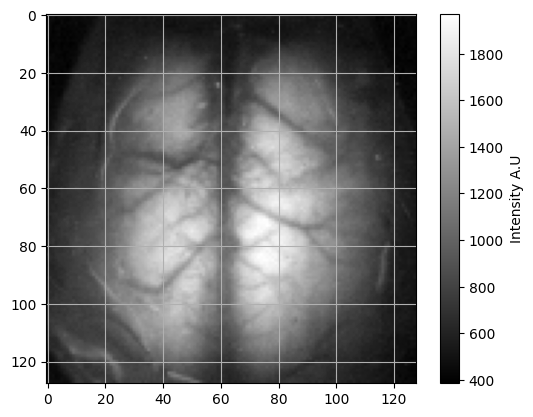

frame number 6000 plotted


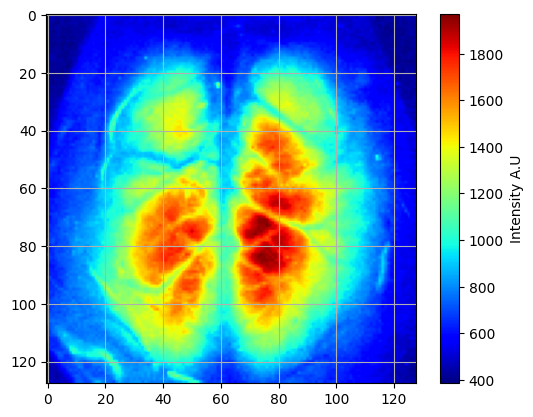

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 442.154443359375 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 497.42374877929683


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 70
Number of double_flash pairs: 35
Number of single_flash: 52
Number of total flashes: 122


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/122 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/122 [00:01<02:27,  1.22s/it]

  2%|█▎                                                                                | 2/122 [00:02<02:34,  1.29s/it]

  2%|██                                                                                | 3/122 [00:03<02:35,  1.31s/it]

  3%|██▋                                                                               | 4/122 [00:05<02:35,  1.31s/it]

  4%|███▎                                                                              | 5/122 [00:06<02:27,  1.26s/it]

  5%|████                                                                              | 6/122 [00:07<02:28,  1.28s/it]

  6%|████▋                                                                             | 7/122 [00:09<02:28,  1.29s/it]

  7%|█████▍                                                                            | 8/122 [00:10<02:34,  1.36s/it]

  7%|██████                                                                            | 9/122 [00:11<02:34,  1.37s/it]

  8%|██████▋                                                                          | 10/122 [00:13<02:31,  1.35s/it]

  9%|███████▎                                                                         | 11/122 [00:14<02:30,  1.36s/it]

 10%|███████▉                                                                         | 12/122 [00:15<02:28,  1.35s/it]

 11%|████████▋                                                                        | 13/122 [00:17<02:20,  1.29s/it]

 11%|█████████▎                                                                       | 14/122 [00:18<02:18,  1.29s/it]

 12%|█████████▉                                                                       | 15/122 [00:19<02:14,  1.25s/it]

 13%|██████████▌                                                                      | 16/122 [00:20<02:12,  1.25s/it]

 14%|███████████▎                                                                     | 17/122 [00:22<02:19,  1.33s/it]

 15%|███████████▉                                                                     | 18/122 [00:23<02:21,  1.36s/it]

 16%|████████████▌                                                                    | 19/122 [00:25<02:21,  1.37s/it]

 16%|█████████████▎                                                                   | 20/122 [00:26<02:18,  1.36s/it]

 17%|█████████████▉                                                                   | 21/122 [00:27<02:13,  1.32s/it]

 18%|██████████████▌                                                                  | 22/122 [00:28<02:12,  1.32s/it]

 19%|███████████████▎                                                                 | 23/122 [00:30<02:16,  1.38s/it]

 20%|███████████████▉                                                                 | 24/122 [00:31<02:12,  1.35s/it]

 20%|████████████████▌                                                                | 25/122 [00:33<02:09,  1.33s/it]

 21%|█████████████████▎                                                               | 26/122 [00:34<02:04,  1.29s/it]

 22%|█████████████████▉                                                               | 27/122 [00:35<02:07,  1.34s/it]

 23%|██████████████████▌                                                              | 28/122 [00:37<02:09,  1.38s/it]

 24%|███████████████████▎                                                             | 29/122 [00:38<02:07,  1.37s/it]

 25%|███████████████████▉                                                             | 30/122 [00:39<02:02,  1.34s/it]

 25%|████████████████████▌                                                            | 31/122 [00:41<02:00,  1.33s/it]

 26%|█████████████████████▏                                                           | 32/122 [00:42<02:03,  1.38s/it]

 27%|█████████████████████▉                                                           | 33/122 [00:43<01:59,  1.34s/it]

 28%|██████████████████████▌                                                          | 34/122 [00:45<01:59,  1.36s/it]

 29%|███████████████████████▏                                                         | 35/122 [00:46<02:02,  1.41s/it]

 30%|███████████████████████▉                                                         | 36/122 [00:48<02:00,  1.40s/it]

 30%|████████████████████████▌                                                        | 37/122 [00:49<01:54,  1.35s/it]

 31%|█████████████████████████▏                                                       | 38/122 [00:50<01:56,  1.38s/it]

 32%|█████████████████████████▉                                                       | 39/122 [00:52<01:54,  1.38s/it]

 33%|██████████████████████████▌                                                      | 40/122 [00:53<01:49,  1.34s/it]

 34%|███████████████████████████▏                                                     | 41/122 [00:54<01:47,  1.32s/it]

 34%|███████████████████████████▉                                                     | 42/122 [00:56<01:48,  1.36s/it]

 35%|████████████████████████████▌                                                    | 43/122 [00:57<01:43,  1.31s/it]

 36%|█████████████████████████████▏                                                   | 44/122 [00:58<01:41,  1.31s/it]

 37%|█████████████████████████████▉                                                   | 45/122 [00:59<01:39,  1.29s/it]

 38%|██████████████████████████████▌                                                  | 46/122 [01:01<01:38,  1.29s/it]

 39%|███████████████████████████████▏                                                 | 47/122 [01:02<01:35,  1.28s/it]

 39%|███████████████████████████████▊                                                 | 48/122 [01:03<01:36,  1.30s/it]

 40%|████████████████████████████████▌                                                | 49/122 [01:05<01:34,  1.30s/it]

 41%|█████████████████████████████████▏                                               | 50/122 [01:06<01:32,  1.29s/it]

 42%|█████████████████████████████████▊                                               | 51/122 [01:07<01:32,  1.30s/it]

 43%|██████████████████████████████████▌                                              | 52/122 [01:08<01:29,  1.28s/it]

 43%|███████████████████████████████████▏                                             | 53/122 [01:10<01:30,  1.31s/it]

 44%|███████████████████████████████████▊                                             | 54/122 [01:11<01:31,  1.34s/it]

 45%|████████████████████████████████████▌                                            | 55/122 [01:12<01:27,  1.31s/it]

 46%|█████████████████████████████████████▏                                           | 56/122 [01:14<01:27,  1.32s/it]

 47%|█████████████████████████████████████▊                                           | 57/122 [01:15<01:27,  1.34s/it]

 48%|██████████████████████████████████████▌                                          | 58/122 [01:17<01:24,  1.32s/it]

 48%|███████████████████████████████████████▏                                         | 59/122 [01:18<01:23,  1.33s/it]

 49%|███████████████████████████████████████▊                                         | 60/122 [01:19<01:23,  1.34s/it]

 50%|████████████████████████████████████████▌                                        | 61/122 [01:21<01:22,  1.36s/it]

 51%|█████████████████████████████████████████▏                                       | 62/122 [01:22<01:18,  1.31s/it]

 52%|█████████████████████████████████████████▊                                       | 63/122 [01:23<01:17,  1.32s/it]

 52%|██████████████████████████████████████████▍                                      | 64/122 [01:24<01:15,  1.29s/it]

 53%|███████████████████████████████████████████▏                                     | 65/122 [01:26<01:14,  1.30s/it]

 54%|███████████████████████████████████████████▊                                     | 66/122 [01:27<01:15,  1.35s/it]

 55%|████████████████████████████████████████████▍                                    | 67/122 [01:28<01:12,  1.32s/it]

 56%|█████████████████████████████████████████████▏                                   | 68/122 [01:30<01:09,  1.29s/it]

 57%|█████████████████████████████████████████████▊                                   | 69/122 [01:31<01:07,  1.27s/it]

 57%|██████████████████████████████████████████████▍                                  | 70/122 [01:32<01:08,  1.31s/it]

 58%|███████████████████████████████████████████████▏                                 | 71/122 [01:34<01:07,  1.32s/it]

 59%|███████████████████████████████████████████████▊                                 | 72/122 [01:35<01:07,  1.35s/it]

 60%|████████████████████████████████████████████████▍                                | 73/122 [01:36<01:03,  1.30s/it]

 61%|█████████████████████████████████████████████████▏                               | 74/122 [01:38<01:03,  1.32s/it]

 61%|█████████████████████████████████████████████████▊                               | 75/122 [01:39<01:03,  1.35s/it]

 62%|██████████████████████████████████████████████████▍                              | 76/122 [01:40<01:03,  1.37s/it]

 63%|███████████████████████████████████████████████████                              | 77/122 [01:42<01:00,  1.35s/it]

 64%|███████████████████████████████████████████████████▊                             | 78/122 [01:43<00:58,  1.32s/it]

 65%|████████████████████████████████████████████████████▍                            | 79/122 [01:44<00:55,  1.29s/it]

 66%|█████████████████████████████████████████████████████                            | 80/122 [01:46<00:54,  1.30s/it]

 66%|█████████████████████████████████████████████████████▊                           | 81/122 [01:47<00:52,  1.28s/it]

 67%|██████████████████████████████████████████████████████▍                          | 82/122 [01:48<00:53,  1.35s/it]

 68%|███████████████████████████████████████████████████████                          | 83/122 [01:50<00:51,  1.33s/it]

 69%|███████████████████████████████████████████████████████▊                         | 84/122 [01:51<00:50,  1.32s/it]

 70%|████████████████████████████████████████████████████████▍                        | 85/122 [01:52<00:49,  1.35s/it]

 70%|█████████████████████████████████████████████████████████                        | 86/122 [01:54<00:48,  1.34s/it]

 71%|█████████████████████████████████████████████████████████▊                       | 87/122 [01:55<00:46,  1.33s/it]

 72%|██████████████████████████████████████████████████████████▍                      | 88/122 [01:56<00:45,  1.34s/it]

 73%|███████████████████████████████████████████████████████████                      | 89/122 [01:58<00:44,  1.34s/it]

 74%|███████████████████████████████████████████████████████████▊                     | 90/122 [01:59<00:41,  1.31s/it]

 75%|████████████████████████████████████████████████████████████▍                    | 91/122 [02:00<00:40,  1.31s/it]

 75%|█████████████████████████████████████████████████████████████                    | 92/122 [02:02<00:39,  1.33s/it]

 76%|█████████████████████████████████████████████████████████████▋                   | 93/122 [02:03<00:38,  1.32s/it]

 77%|██████████████████████████████████████████████████████████████▍                  | 94/122 [02:04<00:37,  1.33s/it]

 78%|███████████████████████████████████████████████████████████████                  | 95/122 [02:05<00:35,  1.30s/it]

 79%|███████████████████████████████████████████████████████████████▋                 | 96/122 [02:07<00:35,  1.35s/it]

 80%|████████████████████████████████████████████████████████████████▍                | 97/122 [02:08<00:34,  1.36s/it]

 80%|█████████████████████████████████████████████████████████████████                | 98/122 [02:10<00:31,  1.33s/it]

 81%|█████████████████████████████████████████████████████████████████▋               | 99/122 [02:11<00:30,  1.31s/it]

 82%|█████████████████████████████████████████████████████████████████▌              | 100/122 [02:12<00:28,  1.30s/it]

 83%|██████████████████████████████████████████████████████████████████▏             | 101/122 [02:13<00:27,  1.32s/it]

 84%|██████████████████████████████████████████████████████████████████▉             | 102/122 [02:15<00:26,  1.32s/it]

 84%|███████████████████████████████████████████████████████████████████▌            | 103/122 [02:16<00:24,  1.31s/it]

 85%|████████████████████████████████████████████████████████████████████▏           | 104/122 [02:17<00:23,  1.29s/it]

 86%|████████████████████████████████████████████████████████████████████▊           | 105/122 [02:19<00:22,  1.30s/it]

 87%|█████████████████████████████████████████████████████████████████████▌          | 106/122 [02:20<00:20,  1.30s/it]

 88%|██████████████████████████████████████████████████████████████████████▏         | 107/122 [02:21<00:19,  1.27s/it]

 89%|██████████████████████████████████████████████████████████████████████▊         | 108/122 [02:22<00:17,  1.27s/it]

 89%|███████████████████████████████████████████████████████████████████████▍        | 109/122 [02:24<00:16,  1.31s/it]

 90%|████████████████████████████████████████████████████████████████████████▏       | 110/122 [02:25<00:16,  1.37s/it]

 91%|████████████████████████████████████████████████████████████████████████▊       | 111/122 [02:27<00:14,  1.35s/it]

 92%|█████████████████████████████████████████████████████████████████████████▍      | 112/122 [02:28<00:13,  1.35s/it]

 93%|██████████████████████████████████████████████████████████████████████████      | 113/122 [02:29<00:11,  1.31s/it]

 93%|██████████████████████████████████████████████████████████████████████████▊     | 114/122 [02:31<00:10,  1.36s/it]

 94%|███████████████████████████████████████████████████████████████████████████▍    | 115/122 [02:32<00:09,  1.38s/it]

 95%|████████████████████████████████████████████████████████████████████████████    | 116/122 [02:33<00:08,  1.37s/it]

 96%|████████████████████████████████████████████████████████████████████████████▋   | 117/122 [02:35<00:06,  1.38s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▍  | 118/122 [02:36<00:05,  1.36s/it]

 98%|██████████████████████████████████████████████████████████████████████████████  | 119/122 [02:37<00:03,  1.33s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▋ | 120/122 [02:39<00:02,  1.34s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▎| 121/122 [02:40<00:01,  1.34s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 122/122 [02:41<00:00,  1.34s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 122/122 [02:41<00:00,  1.33s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 16%|█████████████▏                                                                  | 21/128 [00:00<00:00, 208.00it/s]

 37%|█████████████████████████████▍                                                  | 47/128 [00:00<00:00, 235.76it/s]

 56%|█████████████████████████████████████████████                                   | 72/128 [00:00<00:00, 239.00it/s]

 78%|█████████████████████████████████████████████████████████████▋                 | 100/128 [00:00<00:00, 253.04it/s]

 98%|█████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:00<00:00, 246.77it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 242.98it/s]

  0%|                                                                                        | 0/34495 [00:00<?, ?it/s]

  0%|                                                                              | 28/34495 [00:00<02:04, 277.18it/s]

  0%|▏                                                                             | 57/34495 [00:00<02:02, 281.55it/s]

  0%|▏                                                                             | 86/34495 [00:00<02:16, 252.30it/s]

  0%|▎                                                                            | 113/34495 [00:00<02:13, 256.91it/s]

  0%|▎                                                                            | 139/34495 [00:00<02:16, 251.16it/s]

  0%|▍                                                                            | 168/34495 [00:00<02:11, 261.15it/s]

  1%|▍                                                                            | 195/34495 [00:00<02:10, 262.31it/s]

  1%|▍                                                                            | 222/34495 [00:00<02:10, 263.09it/s]

  1%|▌                                                                            | 249/34495 [00:00<02:19, 245.11it/s]

  1%|▌                                                                            | 277/34495 [00:01<02:14, 254.40it/s]

  1%|▋                                                                            | 303/34495 [00:01<02:16, 250.97it/s]

  1%|▋                                                                            | 331/34495 [00:01<02:12, 257.15it/s]

  1%|▊                                                                            | 358/34495 [00:01<02:11, 258.66it/s]

  1%|▊                                                                            | 385/34495 [00:01<02:10, 260.47it/s]

  1%|▉                                                                            | 413/34495 [00:01<02:08, 265.44it/s]

  1%|▉                                                                            | 440/34495 [00:01<02:08, 264.48it/s]

  1%|█                                                                            | 467/34495 [00:01<02:10, 261.52it/s]

  1%|█                                                                            | 495/34495 [00:01<02:07, 266.17it/s]

  2%|█▏                                                                           | 522/34495 [00:02<02:07, 265.77it/s]

  2%|█▏                                                                           | 549/34495 [00:02<02:08, 264.57it/s]

  2%|█▎                                                                           | 576/34495 [00:02<02:08, 264.81it/s]

  2%|█▎                                                                           | 603/34495 [00:02<02:08, 263.27it/s]

  2%|█▍                                                                           | 630/34495 [00:02<02:09, 260.68it/s]

  2%|█▍                                                                           | 657/34495 [00:02<02:08, 262.66it/s]

  2%|█▌                                                                           | 684/34495 [00:02<02:08, 262.54it/s]

  2%|█▌                                                                           | 712/34495 [00:02<02:06, 266.91it/s]

  2%|█▋                                                                           | 741/34495 [00:02<02:04, 271.36it/s]

  2%|█▋                                                                           | 770/34495 [00:02<02:03, 273.66it/s]

  2%|█▊                                                                           | 798/34495 [00:03<02:02, 274.75it/s]

  2%|█▊                                                                           | 827/34495 [00:03<02:01, 277.64it/s]

  2%|█▉                                                                           | 855/34495 [00:03<02:07, 263.58it/s]

  3%|█▉                                                                           | 882/34495 [00:03<02:18, 242.59it/s]

  3%|██                                                                           | 908/34495 [00:03<02:16, 246.01it/s]

  3%|██                                                                           | 933/34495 [00:03<02:18, 241.76it/s]

  3%|██▏                                                                          | 959/34495 [00:03<02:16, 244.84it/s]

  3%|██▏                                                                          | 987/34495 [00:03<02:12, 253.42it/s]

  3%|██▏                                                                         | 1014/34495 [00:03<02:10, 256.01it/s]

  3%|██▎                                                                         | 1041/34495 [00:04<02:09, 257.85it/s]

  3%|██▎                                                                         | 1070/34495 [00:04<02:06, 264.16it/s]

  3%|██▍                                                                         | 1098/34495 [00:04<02:04, 267.24it/s]

  3%|██▍                                                                         | 1126/34495 [00:04<02:03, 270.22it/s]

  3%|██▌                                                                         | 1154/34495 [00:04<02:03, 269.17it/s]

  3%|██▌                                                                         | 1183/34495 [00:04<02:02, 272.90it/s]

  4%|██▋                                                                         | 1211/34495 [00:04<02:01, 274.21it/s]

  4%|██▋                                                                         | 1241/34495 [00:04<01:58, 280.19it/s]

  4%|██▊                                                                         | 1270/34495 [00:04<02:17, 241.15it/s]

  4%|██▊                                                                         | 1299/34495 [00:04<02:11, 252.75it/s]

  4%|██▉                                                                         | 1329/34495 [00:05<02:05, 264.23it/s]

  4%|██▉                                                                         | 1358/34495 [00:05<02:02, 269.95it/s]

  4%|███                                                                         | 1386/34495 [00:05<02:03, 268.27it/s]

  4%|███                                                                         | 1414/34495 [00:05<02:05, 264.62it/s]

  4%|███▏                                                                        | 1441/34495 [00:05<02:06, 260.64it/s]

  4%|███▏                                                                        | 1468/34495 [00:05<02:09, 254.84it/s]

  4%|███▎                                                                        | 1496/34495 [00:05<02:07, 259.77it/s]

  4%|███▎                                                                        | 1523/34495 [00:05<02:06, 260.49it/s]

  4%|███▍                                                                        | 1550/34495 [00:05<02:05, 261.75it/s]

  5%|███▍                                                                        | 1577/34495 [00:06<02:06, 261.14it/s]

  5%|███▌                                                                        | 1605/34495 [00:06<02:04, 265.12it/s]

  5%|███▌                                                                        | 1634/34495 [00:06<02:01, 270.05it/s]

  5%|███▋                                                                        | 1662/34495 [00:06<02:00, 272.20it/s]

  5%|███▋                                                                        | 1691/34495 [00:06<01:58, 275.85it/s]

  5%|███▊                                                                        | 1720/34495 [00:06<01:57, 279.23it/s]

  5%|███▊                                                                        | 1748/34495 [00:06<02:08, 255.33it/s]

  5%|███▉                                                                        | 1774/34495 [00:06<02:12, 247.69it/s]

  5%|███▉                                                                        | 1800/34495 [00:06<02:13, 244.35it/s]

  5%|████                                                                        | 1826/34495 [00:07<02:12, 246.00it/s]

  5%|████                                                                        | 1855/34495 [00:07<02:07, 256.28it/s]

  5%|████▏                                                                       | 1885/34495 [00:07<02:01, 268.03it/s]

  6%|████▏                                                                       | 1912/34495 [00:07<02:05, 259.62it/s]

  6%|████▎                                                                       | 1941/34495 [00:07<02:02, 266.04it/s]

  6%|████▎                                                                       | 1968/34495 [00:07<02:02, 264.93it/s]

  6%|████▍                                                                       | 1996/34495 [00:07<02:01, 267.00it/s]

  6%|████▍                                                                       | 2023/34495 [00:07<02:12, 245.75it/s]

  6%|████▌                                                                       | 2052/34495 [00:07<02:06, 257.28it/s]

  6%|████▌                                                                       | 2082/34495 [00:07<02:01, 267.11it/s]

  6%|████▋                                                                       | 2109/34495 [00:08<02:08, 251.90it/s]

  6%|████▋                                                                       | 2135/34495 [00:08<02:11, 245.33it/s]

  6%|████▊                                                                       | 2163/34495 [00:08<02:07, 252.73it/s]

  6%|████▊                                                                       | 2189/34495 [00:08<02:21, 228.14it/s]

  6%|████▉                                                                       | 2213/34495 [00:08<02:22, 225.92it/s]

  6%|████▉                                                                       | 2236/34495 [00:08<02:25, 222.25it/s]

  7%|████▉                                                                       | 2261/34495 [00:08<02:20, 229.25it/s]

  7%|█████                                                                       | 2287/34495 [00:08<02:16, 235.92it/s]

  7%|█████                                                                       | 2315/34495 [00:08<02:10, 246.39it/s]

  7%|█████▏                                                                      | 2340/34495 [00:09<02:10, 246.04it/s]

  7%|█████▏                                                                      | 2365/34495 [00:09<02:11, 243.68it/s]

  7%|█████▎                                                                      | 2390/34495 [00:09<02:15, 237.21it/s]

  7%|█████▎                                                                      | 2417/34495 [00:09<02:10, 245.99it/s]

  7%|█████▍                                                                      | 2446/34495 [00:09<02:04, 256.53it/s]

  7%|█████▍                                                                      | 2475/34495 [00:09<02:00, 264.75it/s]

  7%|█████▌                                                                      | 2504/34495 [00:09<01:58, 270.58it/s]

  7%|█████▌                                                                      | 2533/34495 [00:09<01:56, 274.70it/s]

  7%|█████▋                                                                      | 2562/34495 [00:09<01:54, 278.41it/s]

  8%|█████▋                                                                      | 2590/34495 [00:09<01:55, 275.66it/s]

  8%|█████▊                                                                      | 2618/34495 [00:10<01:59, 266.01it/s]

  8%|█████▊                                                                      | 2645/34495 [00:10<02:04, 255.44it/s]

  8%|█████▉                                                                      | 2671/34495 [00:10<02:10, 244.35it/s]

  8%|█████▉                                                                      | 2696/34495 [00:10<02:12, 239.31it/s]

  8%|█████▉                                                                      | 2721/34495 [00:10<02:11, 240.97it/s]

  8%|██████                                                                      | 2749/34495 [00:10<02:06, 250.23it/s]

  8%|██████                                                                      | 2777/34495 [00:10<02:03, 257.04it/s]

  8%|██████▏                                                                     | 2806/34495 [00:10<01:59, 265.86it/s]

  8%|██████▏                                                                     | 2835/34495 [00:10<01:56, 272.14it/s]

  8%|██████▎                                                                     | 2864/34495 [00:11<01:54, 275.80it/s]

  8%|██████▎                                                                     | 2893/34495 [00:11<01:53, 277.87it/s]

  8%|██████▍                                                                     | 2923/34495 [00:11<01:51, 283.25it/s]

  9%|██████▌                                                                     | 2952/34495 [00:11<01:56, 271.56it/s]

  9%|██████▌                                                                     | 2980/34495 [00:11<01:57, 267.12it/s]

  9%|██████▋                                                                     | 3007/34495 [00:11<01:57, 267.21it/s]

  9%|██████▋                                                                     | 3034/34495 [00:11<01:59, 263.48it/s]

  9%|██████▋                                                                     | 3061/34495 [00:11<01:58, 264.63it/s]

  9%|██████▊                                                                     | 3090/34495 [00:11<01:56, 269.69it/s]

  9%|██████▊                                                                     | 3120/34495 [00:12<01:53, 276.96it/s]

  9%|██████▉                                                                     | 3148/34495 [00:12<02:03, 253.37it/s]

  9%|███████                                                                     | 3178/34495 [00:12<01:58, 264.82it/s]

  9%|███████                                                                     | 3205/34495 [00:12<02:07, 245.54it/s]

  9%|███████▏                                                                    | 3234/34495 [00:12<02:02, 256.23it/s]

  9%|███████▏                                                                    | 3261/34495 [00:12<02:04, 250.34it/s]

 10%|███████▏                                                                    | 3290/34495 [00:12<02:00, 258.48it/s]

 10%|███████▎                                                                    | 3317/34495 [00:12<02:02, 253.90it/s]

 10%|███████▎                                                                    | 3346/34495 [00:12<01:58, 261.84it/s]

 10%|███████▍                                                                    | 3373/34495 [00:13<02:01, 255.48it/s]

 10%|███████▍                                                                    | 3401/34495 [00:13<01:58, 261.68it/s]

 10%|███████▌                                                                    | 3428/34495 [00:13<02:03, 251.83it/s]

 10%|███████▌                                                                    | 3454/34495 [00:13<02:12, 234.41it/s]

 10%|███████▋                                                                    | 3482/34495 [00:13<02:07, 244.11it/s]

 10%|███████▋                                                                    | 3507/34495 [00:13<02:06, 245.09it/s]

 10%|███████▊                                                                    | 3532/34495 [00:13<02:05, 245.81it/s]

 10%|███████▊                                                                    | 3558/34495 [00:13<02:05, 245.68it/s]

 10%|███████▉                                                                    | 3586/34495 [00:13<02:01, 254.83it/s]

 10%|███████▉                                                                    | 3615/34495 [00:13<01:56, 264.31it/s]

 11%|████████                                                                    | 3644/34495 [00:14<01:54, 270.28it/s]

 11%|████████                                                                    | 3672/34495 [00:14<01:54, 269.21it/s]

 11%|████████▏                                                                   | 3699/34495 [00:14<01:54, 268.03it/s]

 11%|████████▏                                                                   | 3726/34495 [00:14<01:54, 267.85it/s]

 11%|████████▎                                                                   | 3753/34495 [00:14<01:54, 267.73it/s]

 11%|████████▎                                                                   | 3780/34495 [00:14<02:08, 238.77it/s]

 11%|████████▍                                                                   | 3807/34495 [00:14<02:04, 246.66it/s]

 11%|████████▍                                                                   | 3833/34495 [00:14<02:04, 246.28it/s]

 11%|████████▌                                                                   | 3860/34495 [00:14<02:01, 251.59it/s]

 11%|████████▌                                                                   | 3886/34495 [00:15<02:11, 232.70it/s]

 11%|████████▌                                                                   | 3910/34495 [00:15<02:11, 232.81it/s]

 11%|████████▋                                                                   | 3938/34495 [00:15<02:04, 244.63it/s]

 11%|████████▋                                                                   | 3966/34495 [00:15<02:00, 253.25it/s]

 12%|████████▊                                                                   | 3995/34495 [00:15<01:56, 262.33it/s]

 12%|████████▊                                                                   | 4024/34495 [00:15<01:53, 268.82it/s]

 12%|████████▉                                                                   | 4052/34495 [00:15<01:55, 262.91it/s]

 12%|████████▉                                                                   | 4079/34495 [00:15<01:58, 256.87it/s]

 12%|█████████                                                                   | 4108/34495 [00:15<01:54, 265.57it/s]

 12%|█████████                                                                   | 4137/34495 [00:16<01:52, 270.31it/s]

 12%|█████████▏                                                                  | 4166/34495 [00:16<01:50, 274.46it/s]

 12%|█████████▏                                                                  | 4194/34495 [00:16<01:55, 261.61it/s]

 12%|█████████▎                                                                  | 4221/34495 [00:16<01:58, 255.34it/s]

 12%|█████████▎                                                                  | 4249/34495 [00:16<01:55, 261.57it/s]

 12%|█████████▍                                                                  | 4278/34495 [00:16<01:52, 267.43it/s]

 12%|█████████▍                                                                  | 4305/34495 [00:16<02:01, 247.51it/s]

 13%|█████████▌                                                                  | 4331/34495 [00:16<02:12, 227.20it/s]

 13%|█████████▌                                                                  | 4358/34495 [00:16<02:06, 237.84it/s]

 13%|█████████▋                                                                  | 4387/34495 [00:17<02:00, 250.03it/s]

 13%|█████████▋                                                                  | 4415/34495 [00:17<01:57, 256.06it/s]

 13%|█████████▊                                                                  | 4441/34495 [00:17<01:58, 252.98it/s]

 13%|█████████▊                                                                  | 4469/34495 [00:17<01:56, 258.49it/s]

 13%|█████████▉                                                                  | 4496/34495 [00:17<01:55, 260.33it/s]

 13%|█████████▉                                                                  | 4525/34495 [00:17<01:52, 267.41it/s]

 13%|██████████                                                                  | 4552/34495 [00:17<02:03, 242.08it/s]

 13%|██████████                                                                  | 4579/34495 [00:17<02:00, 249.06it/s]

 13%|██████████▏                                                                 | 4606/34495 [00:17<01:58, 251.43it/s]

 13%|██████████▏                                                                 | 4635/34495 [00:17<01:54, 260.90it/s]

 14%|██████████▎                                                                 | 4664/34495 [00:18<01:51, 267.74it/s]

 14%|██████████▎                                                                 | 4693/34495 [00:18<01:49, 271.86it/s]

 14%|██████████▍                                                                 | 4722/34495 [00:18<01:48, 275.56it/s]

 14%|██████████▍                                                                 | 4751/34495 [00:18<01:46, 278.19it/s]

 14%|██████████▌                                                                 | 4779/34495 [00:18<01:48, 273.93it/s]

 14%|██████████▌                                                                 | 4808/34495 [00:18<01:47, 277.03it/s]

 14%|██████████▋                                                                 | 4836/34495 [00:18<01:47, 277.12it/s]

 14%|██████████▋                                                                 | 4864/34495 [00:18<01:53, 261.81it/s]

 14%|██████████▊                                                                 | 4891/34495 [00:18<01:55, 255.47it/s]

 14%|██████████▊                                                                 | 4917/34495 [00:19<01:57, 251.81it/s]

 14%|██████████▉                                                                 | 4945/34495 [00:19<01:55, 256.91it/s]

 14%|██████████▉                                                                 | 4974/34495 [00:19<01:51, 264.87it/s]

 15%|███████████                                                                 | 5003/34495 [00:19<01:48, 270.60it/s]

 15%|███████████                                                                 | 5034/34495 [00:19<01:45, 278.84it/s]

 15%|███████████▏                                                                | 5062/34495 [00:19<01:51, 263.85it/s]

 15%|███████████▏                                                                | 5089/34495 [00:19<01:52, 261.92it/s]

 15%|███████████▎                                                                | 5118/34495 [00:19<01:49, 269.17it/s]

 15%|███████████▎                                                                | 5146/34495 [00:19<01:49, 269.22it/s]

 15%|███████████▍                                                                | 5175/34495 [00:19<01:47, 273.68it/s]

 15%|███████████▍                                                                | 5203/34495 [00:20<01:48, 269.72it/s]

 15%|███████████▌                                                                | 5233/34495 [00:20<01:45, 277.71it/s]

 15%|███████████▌                                                                | 5261/34495 [00:20<01:51, 262.63it/s]

 15%|███████████▋                                                                | 5288/34495 [00:20<02:01, 239.80it/s]

 15%|███████████▋                                                                | 5315/34495 [00:20<01:58, 246.96it/s]

 15%|███████████▊                                                                | 5341/34495 [00:20<01:58, 245.17it/s]

 16%|███████████▊                                                                | 5368/34495 [00:20<01:56, 250.72it/s]

 16%|███████████▉                                                                | 5394/34495 [00:20<01:57, 248.45it/s]

 16%|███████████▉                                                                | 5420/34495 [00:20<02:05, 231.99it/s]

 16%|████████████                                                                | 5449/34495 [00:21<01:58, 245.80it/s]

 16%|████████████                                                                | 5478/34495 [00:21<01:53, 256.70it/s]

 16%|████████████▏                                                               | 5507/34495 [00:21<01:49, 264.67it/s]

 16%|████████████▏                                                               | 5535/34495 [00:21<01:48, 267.57it/s]

 16%|████████████▎                                                               | 5562/34495 [00:21<01:51, 258.57it/s]

 16%|████████████▎                                                               | 5589/34495 [00:21<01:58, 243.79it/s]

 16%|████████████▎                                                               | 5614/34495 [00:21<01:59, 242.19it/s]

 16%|████████████▍                                                               | 5639/34495 [00:21<02:04, 232.70it/s]

 16%|████████████▍                                                               | 5664/34495 [00:21<02:02, 234.90it/s]

 17%|████████████▌                                                               | 5693/34495 [00:22<01:56, 247.59it/s]

 17%|████████████▌                                                               | 5722/34495 [00:22<01:51, 258.18it/s]

 17%|████████████▋                                                               | 5748/34495 [00:22<02:02, 233.89it/s]

 17%|████████████▋                                                               | 5772/34495 [00:22<02:02, 234.93it/s]

 17%|████████████▊                                                               | 5799/34495 [00:22<01:57, 244.04it/s]

 17%|████████████▊                                                               | 5826/34495 [00:22<01:54, 250.72it/s]

 17%|████████████▉                                                               | 5852/34495 [00:22<01:54, 249.83it/s]

 17%|████████████▉                                                               | 5878/34495 [00:22<01:53, 251.34it/s]

 17%|█████████████                                                               | 5904/34495 [00:22<01:56, 245.33it/s]

 17%|█████████████                                                               | 5930/34495 [00:23<01:54, 248.85it/s]

 17%|█████████████▏                                                              | 5959/34495 [00:23<01:50, 259.40it/s]

 17%|█████████████▏                                                              | 5988/34495 [00:23<01:46, 266.94it/s]

 17%|█████████████▎                                                              | 6015/34495 [00:23<01:46, 267.09it/s]

 18%|█████████████▎                                                              | 6044/34495 [00:23<01:44, 272.25it/s]

 18%|█████████████▍                                                              | 6074/34495 [00:23<01:42, 278.01it/s]

 18%|█████████████▍                                                              | 6102/34495 [00:23<01:45, 269.12it/s]

 18%|█████████████▌                                                              | 6129/34495 [00:23<01:45, 267.85it/s]

 18%|█████████████▌                                                              | 6156/34495 [00:23<01:51, 253.74it/s]

 18%|█████████████▌                                                              | 6182/34495 [00:23<01:52, 251.28it/s]

 18%|█████████████▋                                                              | 6208/34495 [00:24<01:52, 251.64it/s]

 18%|█████████████▋                                                              | 6236/34495 [00:24<01:50, 256.86it/s]

 18%|█████████████▊                                                              | 6263/34495 [00:24<01:48, 259.93it/s]

 18%|█████████████▊                                                              | 6290/34495 [00:24<01:54, 245.72it/s]

 18%|█████████████▉                                                              | 6319/34495 [00:24<01:50, 255.29it/s]

 18%|█████████████▉                                                              | 6345/34495 [00:24<01:52, 249.58it/s]

 18%|██████████████                                                              | 6371/34495 [00:24<01:52, 249.73it/s]

 19%|██████████████                                                              | 6397/34495 [00:24<01:52, 250.54it/s]

 19%|██████████████▏                                                             | 6424/34495 [00:24<01:49, 255.44it/s]

 19%|██████████████▏                                                             | 6452/34495 [00:25<01:48, 259.59it/s]

 19%|██████████████▎                                                             | 6479/34495 [00:25<01:47, 261.13it/s]

 19%|██████████████▎                                                             | 6506/34495 [00:25<01:51, 251.26it/s]

 19%|██████████████▍                                                             | 6532/34495 [00:25<01:55, 242.06it/s]

 19%|██████████████▍                                                             | 6557/34495 [00:25<01:54, 242.95it/s]

 19%|██████████████▌                                                             | 6586/34495 [00:25<01:49, 254.90it/s]

 19%|██████████████▌                                                             | 6613/34495 [00:25<01:48, 257.79it/s]

 19%|██████████████▋                                                             | 6640/34495 [00:25<01:47, 259.86it/s]

 19%|██████████████▋                                                             | 6667/34495 [00:25<01:49, 253.24it/s]

 19%|██████████████▋                                                             | 6693/34495 [00:26<01:49, 253.03it/s]

 19%|██████████████▊                                                             | 6722/34495 [00:26<01:46, 261.60it/s]

 20%|██████████████▊                                                             | 6751/34495 [00:26<01:43, 268.16it/s]

 20%|██████████████▉                                                             | 6778/34495 [00:26<01:45, 261.69it/s]

 20%|██████████████▉                                                             | 6805/34495 [00:26<01:45, 262.62it/s]

 20%|███████████████                                                             | 6832/34495 [00:26<01:47, 257.31it/s]

 20%|███████████████                                                             | 6858/34495 [00:26<01:52, 246.08it/s]

 20%|███████████████▏                                                            | 6886/34495 [00:26<01:48, 254.94it/s]

 20%|███████████████▏                                                            | 6915/34495 [00:26<01:44, 263.50it/s]

 20%|███████████████▎                                                            | 6942/34495 [00:26<01:50, 248.86it/s]

 20%|███████████████▎                                                            | 6968/34495 [00:27<01:51, 247.85it/s]

 20%|███████████████▍                                                            | 6993/34495 [00:27<01:57, 233.98it/s]

 20%|███████████████▍                                                            | 7021/34495 [00:27<01:53, 242.66it/s]

 20%|███████████████▌                                                            | 7049/34495 [00:27<01:49, 250.30it/s]

 21%|███████████████▌                                                            | 7076/34495 [00:27<01:47, 254.46it/s]

 21%|███████████████▋                                                            | 7103/34495 [00:27<01:46, 257.46it/s]

 21%|███████████████▋                                                            | 7129/34495 [00:27<01:51, 244.78it/s]

 21%|███████████████▊                                                            | 7155/34495 [00:27<01:50, 247.69it/s]

 21%|███████████████▊                                                            | 7183/34495 [00:27<01:47, 254.05it/s]

 21%|███████████████▉                                                            | 7212/34495 [00:28<01:43, 262.90it/s]

 21%|███████████████▉                                                            | 7241/34495 [00:28<01:41, 269.23it/s]

 21%|████████████████                                                            | 7270/34495 [00:28<01:39, 273.72it/s]

 21%|████████████████                                                            | 7299/34495 [00:28<01:38, 276.90it/s]

 21%|████████████████▏                                                           | 7327/34495 [00:28<01:42, 263.89it/s]

 21%|████████████████▏                                                           | 7354/34495 [00:28<01:47, 252.70it/s]

 21%|████████████████▎                                                           | 7380/34495 [00:28<01:52, 241.29it/s]

 21%|████████████████▎                                                           | 7405/34495 [00:28<01:52, 240.41it/s]

 22%|████████████████▍                                                           | 7433/34495 [00:28<01:48, 249.39it/s]

 22%|████████████████▍                                                           | 7459/34495 [00:29<01:48, 249.59it/s]

 22%|████████████████▍                                                           | 7485/34495 [00:29<01:49, 247.70it/s]

 22%|████████████████▌                                                           | 7512/34495 [00:29<01:46, 252.27it/s]

 22%|████████████████▌                                                           | 7538/34495 [00:29<01:58, 226.63it/s]

 22%|████████████████▋                                                           | 7562/34495 [00:29<01:58, 227.20it/s]

 22%|████████████████▋                                                           | 7586/34495 [00:29<01:59, 225.17it/s]

 22%|████████████████▊                                                           | 7612/34495 [00:29<01:55, 233.55it/s]

 22%|████████████████▊                                                           | 7639/34495 [00:29<01:50, 243.18it/s]

 22%|████████████████▉                                                           | 7666/34495 [00:29<01:47, 249.47it/s]

 22%|████████████████▉                                                           | 7695/34495 [00:29<01:42, 260.48it/s]

 22%|█████████████████                                                           | 7723/34495 [00:30<01:41, 264.66it/s]

 22%|█████████████████                                                           | 7752/34495 [00:30<01:38, 270.54it/s]

 23%|█████████████████▏                                                          | 7781/34495 [00:30<01:37, 274.67it/s]

 23%|█████████████████▏                                                          | 7809/34495 [00:30<01:38, 271.48it/s]

 23%|█████████████████▎                                                          | 7837/34495 [00:30<01:43, 256.73it/s]

 23%|█████████████████▎                                                          | 7863/34495 [00:30<01:45, 252.70it/s]

 23%|█████████████████▍                                                          | 7889/34495 [00:30<01:51, 239.24it/s]

 23%|█████████████████▍                                                          | 7914/34495 [00:30<01:50, 240.24it/s]

 23%|█████████████████▍                                                          | 7939/34495 [00:30<01:52, 236.38it/s]

 23%|█████████████████▌                                                          | 7965/34495 [00:31<01:49, 241.67it/s]

 23%|█████████████████▌                                                          | 7992/34495 [00:31<01:47, 247.65it/s]

 23%|█████████████████▋                                                          | 8020/34495 [00:31<01:43, 254.79it/s]

 23%|█████████████████▋                                                          | 8046/34495 [00:31<01:48, 243.64it/s]

 23%|█████████████████▊                                                          | 8073/34495 [00:31<01:45, 250.39it/s]

 23%|█████████████████▊                                                          | 8099/34495 [00:31<01:46, 248.90it/s]

 24%|█████████████████▉                                                          | 8124/34495 [00:31<01:48, 242.96it/s]

 24%|█████████████████▉                                                          | 8149/34495 [00:31<01:49, 240.20it/s]

 24%|██████████████████                                                          | 8177/34495 [00:31<01:44, 250.88it/s]

 24%|██████████████████                                                          | 8206/34495 [00:32<01:41, 259.23it/s]

 24%|██████████████████▏                                                         | 8232/34495 [00:32<01:52, 233.65it/s]

 24%|██████████████████▏                                                         | 8258/34495 [00:32<01:49, 239.49it/s]

 24%|██████████████████▏                                                         | 8283/34495 [00:32<01:52, 233.98it/s]

 24%|██████████████████▎                                                         | 8311/34495 [00:32<01:46, 245.41it/s]

 24%|██████████████████▎                                                         | 8336/34495 [00:32<01:50, 237.34it/s]

 24%|██████████████████▍                                                         | 8360/34495 [00:32<01:52, 232.90it/s]

 24%|██████████████████▍                                                         | 8388/34495 [00:32<01:46, 244.11it/s]

 24%|██████████████████▌                                                         | 8414/34495 [00:32<01:45, 247.25it/s]

 24%|██████████████████▌                                                         | 8443/34495 [00:33<01:41, 257.37it/s]

 25%|██████████████████▋                                                         | 8470/34495 [00:33<01:39, 260.68it/s]

 25%|██████████████████▋                                                         | 8499/34495 [00:33<01:37, 267.72it/s]

 25%|██████████████████▊                                                         | 8528/34495 [00:33<01:35, 272.69it/s]

 25%|██████████████████▊                                                         | 8557/34495 [00:33<01:33, 276.19it/s]

 25%|██████████████████▉                                                         | 8586/34495 [00:33<01:33, 277.03it/s]

 25%|██████████████████▉                                                         | 8615/34495 [00:33<01:32, 278.42it/s]

 25%|███████████████████                                                         | 8644/34495 [00:33<01:32, 279.39it/s]

 25%|███████████████████                                                         | 8673/34495 [00:33<01:31, 280.89it/s]

 25%|███████████████████▏                                                        | 8703/34495 [00:33<01:30, 284.04it/s]

 25%|███████████████████▏                                                        | 8732/34495 [00:34<01:38, 262.64it/s]

 25%|███████████████████▎                                                        | 8762/34495 [00:34<01:34, 271.57it/s]

 25%|███████████████████▎                                                        | 8790/34495 [00:34<01:38, 261.39it/s]

 26%|███████████████████▍                                                        | 8820/34495 [00:34<01:35, 269.18it/s]

 26%|███████████████████▍                                                        | 8850/34495 [00:34<01:33, 275.59it/s]

 26%|███████████████████▌                                                        | 8880/34495 [00:34<01:31, 280.99it/s]

 26%|███████████████████▋                                                        | 8909/34495 [00:34<01:32, 276.44it/s]

 26%|███████████████████▋                                                        | 8938/34495 [00:34<01:31, 278.76it/s]

 26%|███████████████████▊                                                        | 8968/34495 [00:34<01:30, 282.49it/s]

 26%|███████████████████▊                                                        | 8997/34495 [00:35<01:34, 270.55it/s]

 26%|███████████████████▉                                                        | 9025/34495 [00:35<01:33, 273.00it/s]

 26%|███████████████████▉                                                        | 9053/34495 [00:35<01:38, 257.97it/s]

 26%|████████████████████                                                        | 9082/34495 [00:35<01:36, 264.26it/s]

 26%|████████████████████                                                        | 9111/34495 [00:35<01:34, 269.73it/s]

 26%|████████████████████▏                                                       | 9139/34495 [00:35<01:35, 266.52it/s]

 27%|████████████████████▏                                                       | 9166/34495 [00:35<01:34, 266.78it/s]

 27%|████████████████████▎                                                       | 9193/34495 [00:35<01:35, 265.44it/s]

 27%|████████████████████▎                                                       | 9222/34495 [00:35<01:33, 270.25it/s]

 27%|████████████████████▍                                                       | 9250/34495 [00:35<01:36, 262.42it/s]

 27%|████████████████████▍                                                       | 9277/34495 [00:36<01:40, 251.67it/s]

 27%|████████████████████▍                                                       | 9303/34495 [00:36<01:41, 248.47it/s]

 27%|████████████████████▌                                                       | 9332/34495 [00:36<01:37, 257.99it/s]

 27%|████████████████████▌                                                       | 9359/34495 [00:36<01:36, 259.96it/s]

 27%|████████████████████▋                                                       | 9386/34495 [00:36<01:36, 259.15it/s]

 27%|████████████████████▋                                                       | 9413/34495 [00:36<01:35, 261.56it/s]

 27%|████████████████████▊                                                       | 9442/34495 [00:36<01:33, 268.31it/s]

 27%|████████████████████▊                                                       | 9471/34495 [00:36<01:31, 272.30it/s]

 28%|████████████████████▉                                                       | 9500/34495 [00:36<01:30, 275.90it/s]

 28%|████████████████████▉                                                       | 9528/34495 [00:37<01:36, 258.17it/s]

 28%|█████████████████████                                                       | 9555/34495 [00:37<01:35, 260.79it/s]

 28%|█████████████████████                                                       | 9582/34495 [00:37<01:35, 261.87it/s]

 28%|█████████████████████▏                                                      | 9609/34495 [00:37<01:36, 259.10it/s]

 28%|█████████████████████▏                                                      | 9636/34495 [00:37<01:41, 244.00it/s]

 28%|█████████████████████▎                                                      | 9663/34495 [00:37<01:39, 248.47it/s]

 28%|█████████████████████▎                                                      | 9690/34495 [00:37<01:37, 253.13it/s]

 28%|█████████████████████▍                                                      | 9716/34495 [00:37<01:38, 252.24it/s]

 28%|█████████████████████▍                                                      | 9744/34495 [00:37<01:36, 257.29it/s]

 28%|█████████████████████▌                                                      | 9771/34495 [00:37<01:35, 260.24it/s]

 28%|█████████████████████▌                                                      | 9798/34495 [00:38<01:35, 259.88it/s]

 28%|█████████████████████▋                                                      | 9825/34495 [00:38<01:37, 254.12it/s]

 29%|█████████████████████▋                                                      | 9851/34495 [00:38<01:44, 236.19it/s]

 29%|█████████████████████▊                                                      | 9879/34495 [00:38<01:39, 246.54it/s]

 29%|█████████████████████▊                                                      | 9904/34495 [00:38<01:42, 239.48it/s]

 29%|█████████████████████▉                                                      | 9929/34495 [00:38<01:41, 241.10it/s]

 29%|█████████████████████▉                                                      | 9956/34495 [00:38<01:38, 247.93it/s]

 29%|█████████████████████▉                                                      | 9983/34495 [00:38<01:37, 252.13it/s]

 29%|█████████████████████▊                                                     | 10012/34495 [00:38<01:33, 261.61it/s]

 29%|█████████████████████▊                                                     | 10039/34495 [00:39<01:35, 256.61it/s]

 29%|█████████████████████▉                                                     | 10065/34495 [00:39<01:36, 253.96it/s]

 29%|█████████████████████▉                                                     | 10092/34495 [00:39<01:34, 257.87it/s]

 29%|█████████████████████▉                                                     | 10118/34495 [00:39<01:37, 249.79it/s]

 29%|██████████████████████                                                     | 10144/34495 [00:39<01:40, 242.32it/s]

 29%|██████████████████████                                                     | 10169/34495 [00:39<01:50, 220.85it/s]

 30%|██████████████████████▏                                                    | 10198/34495 [00:39<01:42, 238.06it/s]

 30%|██████████████████████▏                                                    | 10227/34495 [00:39<01:37, 249.62it/s]

 30%|██████████████████████▎                                                    | 10256/34495 [00:39<01:33, 258.78it/s]

 30%|██████████████████████▎                                                    | 10283/34495 [00:40<01:34, 256.17it/s]

 30%|██████████████████████▍                                                    | 10310/34495 [00:40<01:33, 257.93it/s]

 30%|██████████████████████▍                                                    | 10338/34495 [00:40<01:32, 262.04it/s]

 30%|██████████████████████▌                                                    | 10365/34495 [00:40<01:34, 256.23it/s]

 30%|██████████████████████▌                                                    | 10391/34495 [00:40<01:35, 251.58it/s]

 30%|██████████████████████▋                                                    | 10417/34495 [00:40<01:37, 246.29it/s]

 30%|██████████████████████▋                                                    | 10442/34495 [00:40<01:40, 239.89it/s]

 30%|██████████████████████▊                                                    | 10471/34495 [00:40<01:35, 251.91it/s]

 30%|██████████████████████▊                                                    | 10497/34495 [00:40<01:43, 232.37it/s]

 31%|██████████████████████▉                                                    | 10521/34495 [00:41<01:43, 230.71it/s]

 31%|██████████████████████▉                                                    | 10545/34495 [00:41<01:46, 225.82it/s]

 31%|██████████████████████▉                                                    | 10571/34495 [00:41<01:41, 234.57it/s]

 31%|███████████████████████                                                    | 10598/34495 [00:41<01:38, 242.62it/s]

 31%|███████████████████████                                                    | 10623/34495 [00:41<01:38, 241.99it/s]

 31%|███████████████████████▏                                                   | 10648/34495 [00:41<01:40, 238.16it/s]

 31%|███████████████████████▏                                                   | 10675/34495 [00:41<01:36, 246.59it/s]

 31%|███████████████████████▎                                                   | 10702/34495 [00:41<01:34, 251.93it/s]

 31%|███████████████████████▎                                                   | 10728/34495 [00:41<01:41, 233.87it/s]

 31%|███████████████████████▍                                                   | 10752/34495 [00:42<01:43, 230.49it/s]

 31%|███████████████████████▍                                                   | 10776/34495 [00:42<01:44, 226.84it/s]

 31%|███████████████████████▍                                                   | 10800/34495 [00:42<01:43, 229.90it/s]

 31%|███████████████████████▌                                                   | 10826/34495 [00:42<01:40, 235.81it/s]

 31%|███████████████████████▌                                                   | 10850/34495 [00:42<01:40, 235.02it/s]

 32%|███████████████████████▋                                                   | 10878/34495 [00:42<01:36, 245.91it/s]

 32%|███████████████████████▋                                                   | 10907/34495 [00:42<01:31, 257.25it/s]

 32%|███████████████████████▊                                                   | 10936/34495 [00:42<01:29, 264.53it/s]

 32%|███████████████████████▊                                                   | 10965/34495 [00:42<01:27, 270.43it/s]

 32%|███████████████████████▉                                                   | 10993/34495 [00:42<01:30, 260.28it/s]

 32%|███████████████████████▉                                                   | 11020/34495 [00:43<01:30, 259.38it/s]

 32%|████████████████████████                                                   | 11048/34495 [00:43<01:29, 263.06it/s]

 32%|████████████████████████                                                   | 11075/34495 [00:43<01:29, 260.58it/s]

 32%|████████████████████████▏                                                  | 11102/34495 [00:43<01:29, 261.82it/s]

 32%|████████████████████████▏                                                  | 11129/34495 [00:43<01:31, 256.04it/s]

 32%|████████████████████████▎                                                  | 11156/34495 [00:43<01:30, 257.12it/s]

 32%|████████████████████████▎                                                  | 11184/34495 [00:43<01:28, 262.24it/s]

 33%|████████████████████████▍                                                  | 11211/34495 [00:43<01:32, 252.77it/s]

 33%|████████████████████████▍                                                  | 11237/34495 [00:43<01:34, 247.13it/s]

 33%|████████████████████████▍                                                  | 11267/34495 [00:44<01:28, 261.35it/s]

 33%|████████████████████████▌                                                  | 11297/34495 [00:44<01:25, 270.54it/s]

 33%|████████████████████████▋                                                  | 11327/34495 [00:44<01:23, 277.41it/s]

 33%|████████████████████████▋                                                  | 11355/34495 [00:44<01:28, 261.45it/s]

 33%|████████████████████████▋                                                  | 11382/34495 [00:44<01:32, 249.18it/s]

 33%|████████████████████████▊                                                  | 11408/34495 [00:44<01:35, 242.84it/s]

 33%|████████████████████████▊                                                  | 11435/34495 [00:44<01:32, 249.63it/s]

 33%|████████████████████████▉                                                  | 11462/34495 [00:44<01:30, 254.67it/s]

 33%|████████████████████████▉                                                  | 11490/34495 [00:44<01:28, 258.98it/s]

 33%|█████████████████████████                                                  | 11517/34495 [00:44<01:28, 260.68it/s]

 33%|█████████████████████████                                                  | 11544/34495 [00:45<01:27, 261.89it/s]

 34%|█████████████████████████▏                                                 | 11571/34495 [00:45<01:26, 263.52it/s]

 34%|█████████████████████████▏                                                 | 11598/34495 [00:45<01:33, 244.63it/s]

 34%|█████████████████████████▎                                                 | 11623/34495 [00:45<01:35, 240.13it/s]

 34%|█████████████████████████▎                                                 | 11648/34495 [00:45<01:36, 235.66it/s]

 34%|█████████████████████████▍                                                 | 11673/34495 [00:45<01:35, 238.36it/s]

 34%|█████████████████████████▍                                                 | 11698/34495 [00:45<01:34, 240.33it/s]

 34%|█████████████████████████▍                                                 | 11723/34495 [00:45<01:33, 242.44it/s]

 34%|█████████████████████████▌                                                 | 11748/34495 [00:45<01:33, 243.96it/s]

 34%|█████████████████████████▌                                                 | 11774/34495 [00:46<01:31, 247.96it/s]

 34%|█████████████████████████▋                                                 | 11800/34495 [00:46<01:31, 249.33it/s]

 34%|█████████████████████████▋                                                 | 11829/34495 [00:46<01:27, 259.57it/s]

 34%|█████████████████████████▊                                                 | 11855/34495 [00:46<01:28, 255.96it/s]

 34%|█████████████████████████▊                                                 | 11881/34495 [00:46<01:31, 247.63it/s]

 35%|█████████████████████████▉                                                 | 11906/34495 [00:46<01:33, 240.44it/s]

 35%|█████████████████████████▉                                                 | 11931/34495 [00:46<01:34, 239.80it/s]

 35%|██████████████████████████                                                 | 11960/34495 [00:46<01:29, 252.03it/s]

 35%|██████████████████████████                                                 | 11988/34495 [00:46<01:26, 260.05it/s]

 35%|██████████████████████████▏                                                | 12017/34495 [00:46<01:24, 267.33it/s]

 35%|██████████████████████████▏                                                | 12046/34495 [00:47<01:22, 271.62it/s]

 35%|██████████████████████████▎                                                | 12074/34495 [00:47<01:22, 271.43it/s]

 35%|██████████████████████████▎                                                | 12102/34495 [00:47<01:24, 266.17it/s]

 35%|██████████████████████████▎                                                | 12129/34495 [00:47<01:27, 255.48it/s]

 35%|██████████████████████████▍                                                | 12155/34495 [00:47<01:31, 243.68it/s]

 35%|██████████████████████████▍                                                | 12183/34495 [00:47<01:28, 252.39it/s]

 35%|██████████████████████████▌                                                | 12209/34495 [00:47<01:32, 240.95it/s]

 35%|██████████████████████████▌                                                | 12234/34495 [00:47<01:36, 231.32it/s]

 36%|██████████████████████████▋                                                | 12263/34495 [00:47<01:30, 245.36it/s]

 36%|██████████████████████████▋                                                | 12288/34495 [00:48<01:32, 241.29it/s]

 36%|██████████████████████████▊                                                | 12313/34495 [00:48<01:36, 228.99it/s]

 36%|██████████████████████████▊                                                | 12340/34495 [00:48<01:32, 238.93it/s]

 36%|██████████████████████████▉                                                | 12366/34495 [00:48<01:30, 243.49it/s]

 36%|██████████████████████████▉                                                | 12394/34495 [00:48<01:27, 251.76it/s]

 36%|███████████████████████████                                                | 12420/34495 [00:48<01:28, 249.14it/s]

 36%|███████████████████████████                                                | 12446/34495 [00:48<01:32, 237.95it/s]

 36%|███████████████████████████                                                | 12471/34495 [00:48<01:31, 240.00it/s]

 36%|███████████████████████████▏                                               | 12496/34495 [00:48<01:34, 232.32it/s]

 36%|███████████████████████████▏                                               | 12520/34495 [00:49<01:35, 229.99it/s]

 36%|███████████████████████████▎                                               | 12549/34495 [00:49<01:29, 245.52it/s]

 36%|███████████████████████████▎                                               | 12577/34495 [00:49<01:26, 253.23it/s]

 37%|███████████████████████████▍                                               | 12606/34495 [00:49<01:23, 260.85it/s]

 37%|███████████████████████████▍                                               | 12635/34495 [00:49<01:21, 267.76it/s]

 37%|███████████████████████████▌                                               | 12662/34495 [00:49<01:27, 248.21it/s]

 37%|███████████████████████████▌                                               | 12688/34495 [00:49<01:29, 244.06it/s]

 37%|███████████████████████████▋                                               | 12713/34495 [00:49<01:29, 243.70it/s]

 37%|███████████████████████████▋                                               | 12740/34495 [00:49<01:27, 249.75it/s]

 37%|███████████████████████████▊                                               | 12767/34495 [00:50<01:25, 254.85it/s]

 37%|███████████████████████████▊                                               | 12793/34495 [00:50<01:27, 247.51it/s]

 37%|███████████████████████████▊                                               | 12818/34495 [00:50<01:32, 233.57it/s]

 37%|███████████████████████████▉                                               | 12842/34495 [00:50<01:33, 230.76it/s]

 37%|███████████████████████████▉                                               | 12866/34495 [00:50<01:38, 220.04it/s]

 37%|████████████████████████████                                               | 12893/34495 [00:50<01:32, 233.67it/s]

 37%|████████████████████████████                                               | 12922/34495 [00:50<01:26, 248.14it/s]

 38%|████████████████████████████▏                                              | 12951/34495 [00:50<01:23, 258.63it/s]

 38%|████████████████████████████▏                                              | 12978/34495 [00:50<01:27, 244.99it/s]

 38%|████████████████████████████▎                                              | 13003/34495 [00:51<01:27, 244.37it/s]

 38%|████████████████████████████▎                                              | 13029/34495 [00:51<01:27, 246.72it/s]

 38%|████████████████████████████▍                                              | 13056/34495 [00:51<01:24, 252.69it/s]

 38%|████████████████████████████▍                                              | 13082/34495 [00:51<01:25, 249.77it/s]

 38%|████████████████████████████▍                                              | 13108/34495 [00:51<01:25, 249.16it/s]

 38%|████████████████████████████▌                                              | 13136/34495 [00:51<01:24, 253.70it/s]

 38%|████████████████████████████▌                                              | 13162/34495 [00:51<01:26, 247.69it/s]

 38%|████████████████████████████▋                                              | 13189/34495 [00:51<01:24, 252.64it/s]

 38%|████████████████████████████▋                                              | 13216/34495 [00:51<01:22, 256.94it/s]

 38%|████████████████████████████▊                                              | 13243/34495 [00:51<01:22, 258.51it/s]

 38%|████████████████████████████▊                                              | 13269/34495 [00:52<01:23, 255.25it/s]

 39%|████████████████████████████▉                                              | 13296/34495 [00:52<01:21, 258.82it/s]

 39%|████████████████████████████▉                                              | 13322/34495 [00:52<01:24, 251.10it/s]

 39%|█████████████████████████████                                              | 13348/34495 [00:52<01:26, 243.84it/s]

 39%|█████████████████████████████                                              | 13373/34495 [00:52<01:27, 240.16it/s]

 39%|█████████████████████████████▏                                             | 13398/34495 [00:52<01:27, 240.93it/s]

 39%|█████████████████████████████▏                                             | 13426/34495 [00:52<01:24, 250.73it/s]

 39%|█████████████████████████████▏                                             | 13452/34495 [00:52<01:23, 251.26it/s]

 39%|█████████████████████████████▎                                             | 13479/34495 [00:52<01:22, 255.99it/s]

 39%|█████████████████████████████▎                                             | 13506/34495 [00:53<01:20, 259.37it/s]

 39%|█████████████████████████████▍                                             | 13532/34495 [00:53<01:21, 255.82it/s]

 39%|█████████████████████████████▍                                             | 13559/34495 [00:53<01:20, 259.35it/s]

 39%|█████████████████████████████▌                                             | 13587/34495 [00:53<01:19, 264.17it/s]

 39%|█████████████████████████████▌                                             | 13614/34495 [00:53<01:21, 255.40it/s]

 40%|█████████████████████████████▋                                             | 13640/34495 [00:53<01:23, 250.26it/s]

 40%|█████████████████████████████▋                                             | 13668/34495 [00:53<01:21, 256.61it/s]

 40%|█████████████████████████████▊                                             | 13695/34495 [00:53<01:20, 259.01it/s]

 40%|█████████████████████████████▊                                             | 13721/34495 [00:53<01:21, 254.88it/s]

 40%|█████████████████████████████▉                                             | 13747/34495 [00:53<01:23, 247.08it/s]

 40%|█████████████████████████████▉                                             | 13775/34495 [00:54<01:21, 253.61it/s]

 40%|██████████████████████████████                                             | 13801/34495 [00:54<01:21, 254.01it/s]

 40%|██████████████████████████████                                             | 13828/34495 [00:54<01:20, 256.45it/s]

 40%|██████████████████████████████                                             | 13855/34495 [00:54<01:19, 258.91it/s]

 40%|██████████████████████████████▏                                            | 13881/34495 [00:54<01:20, 257.01it/s]

 40%|██████████████████████████████▏                                            | 13908/34495 [00:54<01:19, 258.57it/s]

 40%|██████████████████████████████▎                                            | 13934/34495 [00:54<01:23, 245.35it/s]

 40%|██████████████████████████████▎                                            | 13959/34495 [00:54<01:27, 234.70it/s]

 41%|██████████████████████████████▍                                            | 13986/34495 [00:54<01:24, 243.88it/s]

 41%|██████████████████████████████▍                                            | 14011/34495 [00:55<01:25, 239.52it/s]

 41%|██████████████████████████████▌                                            | 14038/34495 [00:55<01:22, 246.79it/s]

 41%|██████████████████████████████▌                                            | 14063/34495 [00:55<01:25, 240.16it/s]

 41%|██████████████████████████████▋                                            | 14089/34495 [00:55<01:23, 243.06it/s]

 41%|██████████████████████████████▋                                            | 14115/34495 [00:55<01:22, 247.24it/s]

 41%|██████████████████████████████▊                                            | 14143/34495 [00:55<01:19, 255.29it/s]

 41%|██████████████████████████████▊                                            | 14169/34495 [00:55<01:20, 253.73it/s]

 41%|██████████████████████████████▊                                            | 14196/34495 [00:55<01:18, 257.01it/s]

 41%|██████████████████████████████▉                                            | 14224/34495 [00:55<01:17, 261.48it/s]

 41%|██████████████████████████████▉                                            | 14251/34495 [00:55<01:17, 261.70it/s]

 41%|███████████████████████████████                                            | 14278/34495 [00:56<01:19, 253.03it/s]

 41%|███████████████████████████████                                            | 14306/34495 [00:56<01:17, 260.69it/s]

 42%|███████████████████████████████▏                                           | 14335/34495 [00:56<01:15, 266.90it/s]

 42%|███████████████████████████████▏                                           | 14363/34495 [00:56<01:14, 270.38it/s]

 42%|███████████████████████████████▎                                           | 14392/34495 [00:56<01:13, 274.56it/s]

 42%|███████████████████████████████▎                                           | 14421/34495 [00:56<01:12, 277.50it/s]

 42%|███████████████████████████████▍                                           | 14450/34495 [00:56<01:11, 279.57it/s]

 42%|███████████████████████████████▍                                           | 14479/34495 [00:56<01:11, 280.20it/s]

 42%|███████████████████████████████▌                                           | 14508/34495 [00:56<01:11, 281.46it/s]

 42%|███████████████████████████████▌                                           | 14537/34495 [00:56<01:10, 281.52it/s]

 42%|███████████████████████████████▋                                           | 14566/34495 [00:57<01:10, 282.39it/s]

 42%|███████████████████████████████▋                                           | 14595/34495 [00:57<01:12, 274.93it/s]

 42%|███████████████████████████████▊                                           | 14623/34495 [00:57<01:18, 254.35it/s]

 42%|███████████████████████████████▊                                           | 14651/34495 [00:57<01:16, 258.60it/s]

 43%|███████████████████████████████▉                                           | 14678/34495 [00:57<01:18, 253.31it/s]

 43%|███████████████████████████████▉                                           | 14704/34495 [00:57<01:19, 247.60it/s]

 43%|████████████████████████████████                                           | 14729/34495 [00:57<01:21, 242.21it/s]

 43%|████████████████████████████████                                           | 14758/34495 [00:57<01:17, 254.20it/s]

 43%|████████████████████████████████▏                                          | 14784/34495 [00:57<01:19, 247.43it/s]

 43%|████████████████████████████████▏                                          | 14811/34495 [00:58<01:17, 253.11it/s]

 43%|████████████████████████████████▎                                          | 14837/34495 [00:58<01:19, 248.01it/s]

 43%|████████████████████████████████▎                                          | 14863/34495 [00:58<01:19, 247.92it/s]

 43%|████████████████████████████████▎                                          | 14888/34495 [00:58<01:20, 243.66it/s]

 43%|████████████████████████████████▍                                          | 14913/34495 [00:58<01:19, 244.80it/s]

 43%|████████████████████████████████▍                                          | 14938/34495 [00:58<01:24, 230.95it/s]

 43%|████████████████████████████████▌                                          | 14962/34495 [00:58<01:25, 227.16it/s]

 43%|████████████████████████████████▌                                          | 14991/34495 [00:58<01:20, 243.41it/s]

 44%|████████████████████████████████▋                                          | 15016/34495 [00:58<01:22, 235.92it/s]

 44%|████████████████████████████████▋                                          | 15045/34495 [00:59<01:18, 249.04it/s]

 44%|████████████████████████████████▊                                          | 15071/34495 [00:59<01:20, 240.31it/s]

 44%|████████████████████████████████▊                                          | 15096/34495 [00:59<01:20, 241.75it/s]

 44%|████████████████████████████████▉                                          | 15121/34495 [00:59<01:22, 234.78it/s]

 44%|████████████████████████████████▉                                          | 15145/34495 [00:59<01:22, 235.61it/s]

 44%|████████████████████████████████▉                                          | 15174/34495 [00:59<01:17, 249.75it/s]

 44%|█████████████████████████████████                                          | 15200/34495 [00:59<01:18, 244.96it/s]

 44%|█████████████████████████████████                                          | 15225/34495 [00:59<01:20, 238.92it/s]

 44%|█████████████████████████████████▏                                         | 15249/34495 [00:59<01:21, 236.57it/s]

 44%|█████████████████████████████████▏                                         | 15276/34495 [01:00<01:18, 245.46it/s]

 44%|█████████████████████████████████▎                                         | 15301/34495 [01:00<01:17, 246.09it/s]

 44%|█████████████████████████████████▎                                         | 15329/34495 [01:00<01:15, 253.06it/s]

 45%|█████████████████████████████████▍                                         | 15357/34495 [01:00<01:14, 257.20it/s]

 45%|█████████████████████████████████▍                                         | 15383/34495 [01:00<01:15, 253.61it/s]

 45%|█████████████████████████████████▌                                         | 15412/34495 [01:00<01:12, 261.93it/s]

 45%|█████████████████████████████████▌                                         | 15441/34495 [01:00<01:10, 268.51it/s]

 45%|█████████████████████████████████▋                                         | 15468/34495 [01:00<01:11, 265.93it/s]

 45%|█████████████████████████████████▋                                         | 15497/34495 [01:00<01:09, 271.41it/s]

 45%|█████████████████████████████████▊                                         | 15525/34495 [01:00<01:11, 264.64it/s]

 45%|█████████████████████████████████▊                                         | 15552/34495 [01:01<01:15, 250.34it/s]

 45%|█████████████████████████████████▊                                         | 15578/34495 [01:01<01:15, 250.27it/s]

 45%|█████████████████████████████████▉                                         | 15607/34495 [01:01<01:12, 259.34it/s]

 45%|█████████████████████████████████▉                                         | 15635/34495 [01:01<01:11, 262.28it/s]

 45%|██████████████████████████████████                                         | 15663/34495 [01:01<01:11, 265.12it/s]

 45%|██████████████████████████████████                                         | 15691/34495 [01:01<01:10, 266.37it/s]

 46%|██████████████████████████████████▏                                        | 15720/34495 [01:01<01:09, 271.69it/s]

 46%|██████████████████████████████████▏                                        | 15748/34495 [01:01<01:08, 271.76it/s]

 46%|██████████████████████████████████▎                                        | 15776/34495 [01:01<01:09, 269.48it/s]

 46%|██████████████████████████████████▎                                        | 15803/34495 [01:02<01:09, 268.10it/s]

 46%|██████████████████████████████████▍                                        | 15830/34495 [01:02<01:09, 267.12it/s]

 46%|██████████████████████████████████▍                                        | 15859/34495 [01:02<01:08, 271.48it/s]

 46%|██████████████████████████████████▌                                        | 15887/34495 [01:02<01:08, 273.21it/s]

 46%|██████████████████████████████████▌                                        | 15916/34495 [01:02<01:06, 277.37it/s]

 46%|██████████████████████████████████▋                                        | 15944/34495 [01:02<01:06, 277.36it/s]

 46%|██████████████████████████████████▋                                        | 15973/34495 [01:02<01:06, 279.34it/s]

 46%|██████████████████████████████████▊                                        | 16002/34495 [01:02<01:06, 280.04it/s]

 46%|██████████████████████████████████▊                                        | 16031/34495 [01:02<01:06, 279.71it/s]

 47%|██████████████████████████████████▉                                        | 16059/34495 [01:02<01:07, 274.18it/s]

 47%|██████████████████████████████████▉                                        | 16087/34495 [01:03<01:06, 275.11it/s]

 47%|███████████████████████████████████                                        | 16115/34495 [01:03<01:09, 263.43it/s]

 47%|███████████████████████████████████                                        | 16143/34495 [01:03<01:09, 265.91it/s]

 47%|███████████████████████████████████▏                                       | 16172/34495 [01:03<01:07, 269.77it/s]

 47%|███████████████████████████████████▏                                       | 16201/34495 [01:03<01:07, 271.72it/s]

 47%|███████████████████████████████████▎                                       | 16229/34495 [01:03<01:10, 259.86it/s]

 47%|███████████████████████████████████▎                                       | 16257/34495 [01:03<01:09, 262.61it/s]

 47%|███████████████████████████████████▍                                       | 16285/34495 [01:03<01:08, 264.57it/s]

 47%|███████████████████████████████████▍                                       | 16312/34495 [01:03<01:08, 265.40it/s]

 47%|███████████████████████████████████▌                                       | 16341/34495 [01:04<01:07, 270.21it/s]

 47%|███████████████████████████████████▌                                       | 16370/34495 [01:04<01:06, 272.83it/s]

 48%|███████████████████████████████████▋                                       | 16398/34495 [01:04<01:06, 270.23it/s]

 48%|███████████████████████████████████▋                                       | 16426/34495 [01:04<01:07, 267.66it/s]

 48%|███████████████████████████████████▊                                       | 16455/34495 [01:04<01:06, 272.57it/s]

 48%|███████████████████████████████████▊                                       | 16484/34495 [01:04<01:05, 274.48it/s]

 48%|███████████████████████████████████▉                                       | 16514/34495 [01:04<01:04, 278.70it/s]

 48%|███████████████████████████████████▉                                       | 16542/34495 [01:04<01:07, 267.42it/s]

 48%|████████████████████████████████████                                       | 16571/34495 [01:04<01:05, 272.34it/s]

 48%|████████████████████████████████████                                       | 16600/34495 [01:04<01:04, 275.87it/s]

 48%|████████████████████████████████████▏                                      | 16628/34495 [01:05<01:04, 275.50it/s]

 48%|████████████████████████████████████▏                                      | 16656/34495 [01:05<01:07, 262.98it/s]

 48%|████████████████████████████████████▎                                      | 16683/34495 [01:05<01:07, 262.29it/s]

 48%|████████████████████████████████████▎                                      | 16712/34495 [01:05<01:06, 268.27it/s]

 49%|████████████████████████████████████▍                                      | 16740/34495 [01:05<01:05, 271.63it/s]

 49%|████████████████████████████████████▍                                      | 16768/34495 [01:05<01:04, 273.31it/s]

 49%|████████████████████████████████████▌                                      | 16796/34495 [01:05<01:04, 274.50it/s]

 49%|████████████████████████████████████▌                                      | 16825/34495 [01:05<01:03, 277.47it/s]

 49%|████████████████████████████████████▋                                      | 16853/34495 [01:05<01:04, 274.20it/s]

 49%|████████████████████████████████████▋                                      | 16882/34495 [01:05<01:03, 275.63it/s]

 49%|████████████████████████████████████▊                                      | 16910/34495 [01:06<01:06, 265.28it/s]

 49%|████████████████████████████████████▊                                      | 16938/34495 [01:06<01:05, 267.99it/s]

 49%|████████████████████████████████████▉                                      | 16965/34495 [01:06<01:06, 262.53it/s]

 49%|████████████████████████████████████▉                                      | 16993/34495 [01:06<01:05, 266.06it/s]

 49%|█████████████████████████████████████                                      | 17020/34495 [01:06<01:07, 257.52it/s]

 49%|█████████████████████████████████████                                      | 17047/34495 [01:06<01:07, 260.37it/s]

 49%|█████████████████████████████████████                                      | 17075/34495 [01:06<01:06, 263.78it/s]

 50%|█████████████████████████████████████▏                                     | 17102/34495 [01:06<01:06, 261.07it/s]

 50%|█████████████████████████████████████▏                                     | 17129/34495 [01:06<01:07, 259.18it/s]

 50%|█████████████████████████████████████▎                                     | 17159/34495 [01:07<01:04, 269.46it/s]

 50%|█████████████████████████████████████▎                                     | 17189/34495 [01:07<01:02, 275.97it/s]

 50%|█████████████████████████████████████▍                                     | 17217/34495 [01:07<01:03, 271.63it/s]

 50%|█████████████████████████████████████▍                                     | 17245/34495 [01:07<01:04, 267.87it/s]

 50%|█████████████████████████████████████▌                                     | 17272/34495 [01:07<01:04, 267.74it/s]

 50%|█████████████████████████████████████▌                                     | 17299/34495 [01:07<01:09, 247.53it/s]

 50%|█████████████████████████████████████▋                                     | 17329/34495 [01:07<01:05, 260.66it/s]

 50%|█████████████████████████████████████▋                                     | 17359/34495 [01:07<01:03, 270.28it/s]

 50%|█████████████████████████████████████▊                                     | 17387/34495 [01:07<01:03, 268.48it/s]

 50%|█████████████████████████████████████▊                                     | 17415/34495 [01:08<01:03, 270.27it/s]

 51%|█████████████████████████████████████▉                                     | 17444/34495 [01:08<01:01, 275.21it/s]

 51%|█████████████████████████████████████▉                                     | 17472/34495 [01:08<01:02, 273.61it/s]

 51%|██████████████████████████████████████                                     | 17500/34495 [01:08<01:01, 274.47it/s]

 51%|██████████████████████████████████████                                     | 17528/34495 [01:08<01:04, 262.23it/s]

 51%|██████████████████████████████████████▏                                    | 17557/34495 [01:08<01:03, 267.88it/s]

 51%|██████████████████████████████████████▏                                    | 17584/34495 [01:08<01:04, 261.75it/s]

 51%|██████████████████████████████████████▎                                    | 17611/34495 [01:08<01:08, 245.21it/s]

 51%|██████████████████████████████████████▎                                    | 17636/34495 [01:08<01:13, 228.93it/s]

 51%|██████████████████████████████████████▍                                    | 17660/34495 [01:09<01:14, 227.06it/s]

 51%|██████████████████████████████████████▍                                    | 17683/34495 [01:09<01:15, 221.26it/s]

 51%|██████████████████████████████████████▌                                    | 17712/34495 [01:09<01:10, 238.17it/s]

 51%|██████████████████████████████████████▌                                    | 17737/34495 [01:09<01:11, 234.30it/s]

 51%|██████████████████████████████████████▌                                    | 17761/34495 [01:09<01:13, 228.88it/s]

 52%|██████████████████████████████████████▋                                    | 17784/34495 [01:09<01:13, 227.95it/s]

 52%|██████████████████████████████████████▋                                    | 17813/34495 [01:09<01:08, 243.52it/s]

 52%|██████████████████████████████████████▊                                    | 17841/34495 [01:09<01:05, 253.29it/s]

 52%|██████████████████████████████████████▊                                    | 17870/34495 [01:09<01:03, 261.69it/s]

 52%|██████████████████████████████████████▉                                    | 17899/34495 [01:09<01:01, 268.40it/s]

 52%|██████████████████████████████████████▉                                    | 17928/34495 [01:10<01:01, 270.79it/s]

 52%|███████████████████████████████████████                                    | 17956/34495 [01:10<01:07, 243.66it/s]

 52%|███████████████████████████████████████                                    | 17984/34495 [01:10<01:05, 250.81it/s]

 52%|███████████████████████████████████████▏                                   | 18011/34495 [01:10<01:04, 255.44it/s]

 52%|███████████████████████████████████████▏                                   | 18037/34495 [01:10<01:06, 246.31it/s]

 52%|███████████████████████████████████████▎                                   | 18066/34495 [01:10<01:04, 256.40it/s]

 52%|███████████████████████████████████████▎                                   | 18095/34495 [01:10<01:02, 263.71it/s]

 53%|███████████████████████████████████████▍                                   | 18124/34495 [01:10<01:00, 269.73it/s]

 53%|███████████████████████████████████████▍                                   | 18152/34495 [01:10<01:03, 256.81it/s]

 53%|███████████████████████████████████████▌                                   | 18178/34495 [01:11<01:03, 256.99it/s]

 53%|███████████████████████████████████████▌                                   | 18208/34495 [01:11<01:01, 266.57it/s]

 53%|███████████████████████████████████████▋                                   | 18236/34495 [01:11<01:00, 269.01it/s]

 53%|███████████████████████████████████████▋                                   | 18264/34495 [01:11<01:02, 260.10it/s]

 53%|███████████████████████████████████████▊                                   | 18291/34495 [01:11<01:03, 253.59it/s]

 53%|███████████████████████████████████████▊                                   | 18318/34495 [01:11<01:02, 256.79it/s]

 53%|███████████████████████████████████████▉                                   | 18347/34495 [01:11<01:00, 265.53it/s]

 53%|███████████████████████████████████████▉                                   | 18374/34495 [01:11<01:01, 262.31it/s]

 53%|████████████████████████████████████████                                   | 18401/34495 [01:11<01:02, 255.70it/s]

 53%|████████████████████████████████████████                                   | 18430/34495 [01:12<01:00, 264.00it/s]

 54%|████████████████████████████████████████▏                                  | 18457/34495 [01:12<01:02, 254.75it/s]

 54%|████████████████████████████████████████▏                                  | 18483/34495 [01:12<01:04, 249.90it/s]

 54%|████████████████████████████████████████▏                                  | 18512/34495 [01:12<01:01, 259.80it/s]

 54%|████████████████████████████████████████▎                                  | 18541/34495 [01:12<00:59, 266.20it/s]

 54%|████████████████████████████████████████▎                                  | 18568/34495 [01:12<01:03, 252.73it/s]

 54%|████████████████████████████████████████▍                                  | 18594/34495 [01:12<01:04, 247.85it/s]

 54%|████████████████████████████████████████▍                                  | 18619/34495 [01:12<01:05, 242.36it/s]

 54%|████████████████████████████████████████▌                                  | 18646/34495 [01:12<01:03, 248.76it/s]

 54%|████████████████████████████████████████▌                                  | 18673/34495 [01:12<01:02, 254.12it/s]

 54%|████████████████████████████████████████▋                                  | 18699/34495 [01:13<01:02, 252.93it/s]

 54%|████████████████████████████████████████▋                                  | 18727/34495 [01:13<01:01, 257.82it/s]

 54%|████████████████████████████████████████▊                                  | 18753/34495 [01:13<01:02, 253.33it/s]

 54%|████████████████████████████████████████▊                                  | 18780/34495 [01:13<01:01, 255.96it/s]

 55%|████████████████████████████████████████▉                                  | 18806/34495 [01:13<01:03, 246.42it/s]

 55%|████████████████████████████████████████▉                                  | 18833/34495 [01:13<01:02, 251.73it/s]

 55%|█████████████████████████████████████████                                  | 18861/34495 [01:13<01:00, 257.67it/s]

 55%|█████████████████████████████████████████                                  | 18887/34495 [01:13<01:01, 252.53it/s]

 55%|█████████████████████████████████████████▏                                 | 18915/34495 [01:13<01:00, 258.97it/s]

 55%|█████████████████████████████████████████▏                                 | 18941/34495 [01:14<01:03, 243.07it/s]

 55%|█████████████████████████████████████████▏                                 | 18969/34495 [01:14<01:01, 252.73it/s]

 55%|█████████████████████████████████████████▎                                 | 18995/34495 [01:14<01:01, 252.90it/s]

 55%|█████████████████████████████████████████▎                                 | 19021/34495 [01:14<01:02, 249.27it/s]

 55%|█████████████████████████████████████████▍                                 | 19048/34495 [01:14<01:01, 253.07it/s]

 55%|█████████████████████████████████████████▍                                 | 19074/34495 [01:14<01:07, 227.50it/s]

 55%|█████████████████████████████████████████▌                                 | 19100/34495 [01:14<01:05, 235.00it/s]

 55%|█████████████████████████████████████████▌                                 | 19125/34495 [01:14<01:04, 238.52it/s]

 56%|█████████████████████████████████████████▋                                 | 19151/34495 [01:14<01:03, 243.24it/s]

 56%|█████████████████████████████████████████▋                                 | 19178/34495 [01:15<01:01, 250.22it/s]

 56%|█████████████████████████████████████████▊                                 | 19204/34495 [01:15<01:02, 245.95it/s]

 56%|█████████████████████████████████████████▊                                 | 19229/34495 [01:15<01:03, 241.60it/s]

 56%|█████████████████████████████████████████▊                                 | 19256/34495 [01:15<01:01, 247.63it/s]

 56%|█████████████████████████████████████████▉                                 | 19281/34495 [01:15<01:03, 240.03it/s]

 56%|█████████████████████████████████████████▉                                 | 19309/34495 [01:15<01:00, 250.73it/s]

 56%|██████████████████████████████████████████                                 | 19338/34495 [01:15<00:58, 259.85it/s]

 56%|██████████████████████████████████████████                                 | 19367/34495 [01:15<00:56, 267.08it/s]

 56%|██████████████████████████████████████████▏                                | 19394/34495 [01:15<00:57, 261.10it/s]

 56%|██████████████████████████████████████████▏                                | 19423/34495 [01:15<00:56, 267.93it/s]

 56%|██████████████████████████████████████████▎                                | 19450/34495 [01:16<01:02, 239.94it/s]

 56%|██████████████████████████████████████████▎                                | 19475/34495 [01:16<01:03, 237.55it/s]

 57%|██████████████████████████████████████████▍                                | 19501/34495 [01:16<01:01, 242.41it/s]

 57%|██████████████████████████████████████████▍                                | 19529/34495 [01:16<00:59, 250.88it/s]

 57%|██████████████████████████████████████████▌                                | 19556/34495 [01:16<00:58, 254.18it/s]

 57%|██████████████████████████████████████████▌                                | 19582/34495 [01:16<01:00, 246.67it/s]

 57%|██████████████████████████████████████████▋                                | 19607/34495 [01:16<01:00, 244.86it/s]

 57%|██████████████████████████████████████████▋                                | 19635/34495 [01:16<00:58, 252.77it/s]

 57%|██████████████████████████████████████████▊                                | 19664/34495 [01:16<00:56, 262.02it/s]

 57%|██████████████████████████████████████████▊                                | 19691/34495 [01:17<00:58, 253.33it/s]

 57%|██████████████████████████████████████████▊                                | 19719/34495 [01:17<00:56, 259.47it/s]

 57%|██████████████████████████████████████████▉                                | 19746/34495 [01:17<00:59, 249.49it/s]

 57%|██████████████████████████████████████████▉                                | 19772/34495 [01:17<01:01, 239.04it/s]

 57%|███████████████████████████████████████████                                | 19798/34495 [01:17<01:00, 243.76it/s]

 57%|███████████████████████████████████████████                                | 19823/34495 [01:17<01:00, 244.53it/s]

 58%|███████████████████████████████████████████▏                               | 19849/34495 [01:17<00:59, 247.57it/s]

 58%|███████████████████████████████████████████▏                               | 19878/34495 [01:17<00:56, 258.36it/s]

 58%|███████████████████████████████████████████▎                               | 19904/34495 [01:17<00:59, 246.67it/s]

 58%|███████████████████████████████████████████▎                               | 19932/34495 [01:18<00:57, 253.99it/s]

 58%|███████████████████████████████████████████▍                               | 19959/34495 [01:18<00:56, 257.87it/s]

 58%|███████████████████████████████████████████▍                               | 19987/34495 [01:18<00:55, 262.04it/s]

 58%|███████████████████████████████████████████▌                               | 20015/34495 [01:18<00:54, 264.98it/s]

 58%|███████████████████████████████████████████▌                               | 20042/34495 [01:18<00:58, 247.01it/s]

 58%|███████████████████████████████████████████▋                               | 20067/34495 [01:18<00:59, 244.46it/s]

 58%|███████████████████████████████████████████▋                               | 20092/34495 [01:18<01:01, 233.54it/s]

 58%|███████████████████████████████████████████▋                               | 20116/34495 [01:18<01:02, 231.51it/s]

 58%|███████████████████████████████████████████▊                               | 20142/34495 [01:18<01:00, 237.52it/s]

 58%|███████████████████████████████████████████▊                               | 20167/34495 [01:18<00:59, 239.05it/s]

 59%|███████████████████████████████████████████▉                               | 20191/34495 [01:19<01:00, 234.64it/s]

 59%|███████████████████████████████████████████▉                               | 20215/34495 [01:19<01:03, 225.85it/s]

 59%|████████████████████████████████████████████                               | 20238/34495 [01:19<01:03, 225.77it/s]

 59%|████████████████████████████████████████████                               | 20265/34495 [01:19<00:59, 237.75it/s]

 59%|████████████████████████████████████████████                               | 20289/34495 [01:19<01:01, 231.73it/s]

 59%|████████████████████████████████████████████▏                              | 20316/34495 [01:19<00:59, 239.97it/s]

 59%|████████████████████████████████████████████▏                              | 20342/34495 [01:19<00:57, 244.36it/s]

 59%|████████████████████████████████████████████▎                              | 20367/34495 [01:19<00:58, 242.51it/s]

 59%|████████████████████████████████████████████▎                              | 20394/34495 [01:19<00:56, 249.79it/s]

 59%|████████████████████████████████████████████▍                              | 20420/34495 [01:20<00:57, 244.23it/s]

 59%|████████████████████████████████████████████▍                              | 20447/34495 [01:20<00:56, 249.52it/s]

 59%|████████████████████████████████████████████▌                              | 20475/34495 [01:20<00:54, 258.11it/s]

 59%|████████████████████████████████████████████▌                              | 20504/34495 [01:20<00:52, 265.74it/s]

 60%|████████████████████████████████████████████▋                              | 20531/34495 [01:20<00:53, 261.03it/s]

 60%|████████████████████████████████████████████▋                              | 20558/34495 [01:20<00:55, 250.44it/s]

 60%|████████████████████████████████████████████▊                              | 20584/34495 [01:20<01:00, 231.56it/s]

 60%|████████████████████████████████████████████▊                              | 20612/34495 [01:20<00:57, 242.05it/s]

 60%|████████████████████████████████████████████▊                              | 20637/34495 [01:20<00:57, 242.26it/s]

 60%|████████████████████████████████████████████▉                              | 20665/34495 [01:21<00:55, 250.09it/s]

 60%|████████████████████████████████████████████▉                              | 20691/34495 [01:21<00:55, 246.63it/s]

 60%|█████████████████████████████████████████████                              | 20716/34495 [01:21<00:56, 242.79it/s]

 60%|█████████████████████████████████████████████                              | 20741/34495 [01:21<00:56, 244.17it/s]

 60%|█████████████████████████████████████████████▏                             | 20766/34495 [01:21<00:58, 234.39it/s]

 60%|█████████████████████████████████████████████▏                             | 20793/34495 [01:21<00:56, 243.09it/s]

 60%|█████████████████████████████████████████████▎                             | 20818/34495 [01:21<00:58, 234.37it/s]

 60%|█████████████████████████████████████████████▎                             | 20844/34495 [01:21<00:56, 239.58it/s]

 61%|█████████████████████████████████████████████▍                             | 20872/34495 [01:21<00:54, 248.99it/s]

 61%|█████████████████████████████████████████████▍                             | 20899/34495 [01:21<00:54, 251.44it/s]

 61%|█████████████████████████████████████████████▍                             | 20925/34495 [01:22<00:54, 251.04it/s]

 61%|█████████████████████████████████████████████▌                             | 20951/34495 [01:22<00:54, 246.53it/s]

 61%|█████████████████████████████████████████████▌                             | 20976/34495 [01:22<00:55, 243.37it/s]

 61%|█████████████████████████████████████████████▋                             | 21001/34495 [01:22<00:58, 231.36it/s]

 61%|█████████████████████████████████████████████▋                             | 21025/34495 [01:22<00:58, 229.32it/s]

 61%|█████████████████████████████████████████████▊                             | 21049/34495 [01:22<01:01, 217.67it/s]

 61%|█████████████████████████████████████████████▊                             | 21073/34495 [01:22<01:00, 221.98it/s]

 61%|█████████████████████████████████████████████▉                             | 21101/34495 [01:22<00:56, 236.22it/s]

 61%|█████████████████████████████████████████████▉                             | 21126/34495 [01:22<00:56, 237.46it/s]

 61%|█████████████████████████████████████████████▉                             | 21151/34495 [01:23<00:55, 239.02it/s]

 61%|██████████████████████████████████████████████                             | 21175/34495 [01:23<00:55, 238.64it/s]

 61%|██████████████████████████████████████████████                             | 21204/34495 [01:23<00:52, 251.43it/s]

 62%|██████████████████████████████████████████████▏                            | 21230/34495 [01:23<00:54, 244.80it/s]

 62%|██████████████████████████████████████████████▏                            | 21255/34495 [01:23<00:54, 244.92it/s]

 62%|██████████████████████████████████████████████▎                            | 21280/34495 [01:23<00:55, 240.16it/s]

 62%|██████████████████████████████████████████████▎                            | 21305/34495 [01:23<00:58, 225.52it/s]

 62%|██████████████████████████████████████████████▎                            | 21328/34495 [01:23<01:01, 214.37it/s]

 62%|██████████████████████████████████████████████▍                            | 21356/34495 [01:23<00:56, 230.95it/s]

 62%|██████████████████████████████████████████████▍                            | 21382/34495 [01:24<00:55, 236.43it/s]

 62%|██████████████████████████████████████████████▌                            | 21410/34495 [01:24<00:53, 245.98it/s]

 62%|██████████████████████████████████████████████▌                            | 21437/34495 [01:24<00:52, 247.91it/s]

 62%|██████████████████████████████████████████████▋                            | 21462/34495 [01:24<00:55, 236.39it/s]

 62%|██████████████████████████████████████████████▋                            | 21486/34495 [01:24<00:57, 227.27it/s]

 62%|██████████████████████████████████████████████▊                            | 21512/34495 [01:24<00:55, 235.04it/s]

 62%|██████████████████████████████████████████████▊                            | 21541/34495 [01:24<00:52, 247.78it/s]

 63%|██████████████████████████████████████████████▉                            | 21566/34495 [01:24<00:52, 247.03it/s]

 63%|██████████████████████████████████████████████▉                            | 21593/34495 [01:24<00:51, 252.95it/s]

 63%|███████████████████████████████████████████████                            | 21619/34495 [01:25<00:51, 247.82it/s]

 63%|███████████████████████████████████████████████                            | 21644/34495 [01:25<00:54, 235.60it/s]

 63%|███████████████████████████████████████████████                            | 21668/34495 [01:25<01:00, 212.43it/s]

 63%|███████████████████████████████████████████████▏                           | 21690/34495 [01:25<01:00, 211.11it/s]

 63%|███████████████████████████████████████████████▏                           | 21712/34495 [01:25<01:01, 209.01it/s]

 63%|███████████████████████████████████████████████▎                           | 21740/34495 [01:25<00:55, 227.92it/s]

 63%|███████████████████████████████████████████████▎                           | 21769/34495 [01:25<00:52, 243.36it/s]

 63%|███████████████████████████████████████████████▍                           | 21798/34495 [01:25<00:49, 255.23it/s]

 63%|███████████████████████████████████████████████▍                           | 21824/34495 [01:25<00:51, 246.68it/s]

 63%|███████████████████████████████████████████████▌                           | 21851/34495 [01:26<00:50, 252.61it/s]

 63%|███████████████████████████████████████████████▌                           | 21878/34495 [01:26<00:49, 256.17it/s]

 63%|███████████████████████████████████████████████▌                           | 21904/34495 [01:26<00:50, 248.65it/s]

 64%|███████████████████████████████████████████████▋                           | 21930/34495 [01:26<00:50, 250.35it/s]

 64%|███████████████████████████████████████████████▋                           | 21956/34495 [01:26<00:53, 235.49it/s]

 64%|███████████████████████████████████████████████▊                           | 21983/34495 [01:26<00:51, 243.06it/s]

 64%|███████████████████████████████████████████████▊                           | 22008/34495 [01:26<00:51, 242.99it/s]

 64%|███████████████████████████████████████████████▉                           | 22034/34495 [01:26<00:50, 247.12it/s]

 64%|███████████████████████████████████████████████▉                           | 22059/34495 [01:26<00:55, 224.65it/s]

 64%|████████████████████████████████████████████████                           | 22085/34495 [01:27<00:53, 232.40it/s]

 64%|████████████████████████████████████████████████                           | 22112/34495 [01:27<00:51, 241.55it/s]

 64%|████████████████████████████████████████████████▏                          | 22141/34495 [01:27<00:48, 253.16it/s]

 64%|████████████████████████████████████████████████▏                          | 22169/34495 [01:27<00:47, 257.93it/s]

 64%|████████████████████████████████████████████████▎                          | 22195/34495 [01:27<00:48, 254.16it/s]

 64%|████████████████████████████████████████████████▎                          | 22223/34495 [01:27<00:47, 259.39it/s]

 65%|████████████████████████████████████████████████▍                          | 22250/34495 [01:27<00:47, 255.82it/s]

 65%|████████████████████████████████████████████████▍                          | 22276/34495 [01:27<00:48, 249.87it/s]

 65%|████████████████████████████████████████████████▍                          | 22304/34495 [01:27<00:47, 257.76it/s]

 65%|████████████████████████████████████████████████▌                          | 22330/34495 [01:27<00:48, 253.31it/s]

 65%|████████████████████████████████████████████████▌                          | 22356/34495 [01:28<00:48, 252.36it/s]

 65%|████████████████████████████████████████████████▋                          | 22382/34495 [01:28<00:49, 246.06it/s]

 65%|████████████████████████████████████████████████▋                          | 22407/34495 [01:28<00:49, 245.81it/s]

 65%|████████████████████████████████████████████████▊                          | 22433/34495 [01:28<00:48, 247.79it/s]

 65%|████████████████████████████████████████████████▊                          | 22458/34495 [01:28<00:49, 244.21it/s]

 65%|████████████████████████████████████████████████▉                          | 22486/34495 [01:28<00:47, 251.68it/s]

 65%|████████████████████████████████████████████████▉                          | 22512/34495 [01:28<00:48, 248.36it/s]

 65%|█████████████████████████████████████████████████                          | 22537/34495 [01:28<00:50, 235.94it/s]

 65%|█████████████████████████████████████████████████                          | 22565/34495 [01:28<00:48, 245.58it/s]

 65%|█████████████████████████████████████████████████                          | 22590/34495 [01:29<00:51, 231.11it/s]

 66%|█████████████████████████████████████████████████▏                         | 22617/34495 [01:29<00:49, 241.18it/s]

 66%|█████████████████████████████████████████████████▏                         | 22643/34495 [01:29<00:48, 244.44it/s]

 66%|█████████████████████████████████████████████████▎                         | 22672/34495 [01:29<00:46, 256.02it/s]

 66%|█████████████████████████████████████████████████▎                         | 22700/34495 [01:29<00:44, 262.92it/s]

 66%|█████████████████████████████████████████████████▍                         | 22727/34495 [01:29<00:46, 253.95it/s]

 66%|█████████████████████████████████████████████████▍                         | 22753/34495 [01:29<00:47, 249.30it/s]

 66%|█████████████████████████████████████████████████▌                         | 22779/34495 [01:29<00:47, 246.70it/s]

 66%|█████████████████████████████████████████████████▌                         | 22805/34495 [01:29<00:47, 248.45it/s]

 66%|█████████████████████████████████████████████████▋                         | 22834/34495 [01:29<00:45, 258.19it/s]

 66%|█████████████████████████████████████████████████▋                         | 22864/34495 [01:30<00:43, 269.53it/s]

 66%|█████████████████████████████████████████████████▊                         | 22894/34495 [01:30<00:41, 276.84it/s]

 66%|█████████████████████████████████████████████████▊                         | 22924/34495 [01:30<00:41, 281.18it/s]

 67%|█████████████████████████████████████████████████▉                         | 22954/34495 [01:30<00:40, 284.23it/s]

 67%|█████████████████████████████████████████████████▉                         | 22983/34495 [01:30<00:45, 253.26it/s]

 67%|██████████████████████████████████████████████████                         | 23010/34495 [01:30<00:44, 257.13it/s]

 67%|██████████████████████████████████████████████████                         | 23037/34495 [01:30<00:44, 260.02it/s]

 67%|██████████████████████████████████████████████████▏                        | 23064/34495 [01:30<00:45, 252.14it/s]

 67%|██████████████████████████████████████████████████▏                        | 23092/34495 [01:30<00:44, 254.98it/s]

 67%|██████████████████████████████████████████████████▎                        | 23119/34495 [01:31<00:44, 257.07it/s]

 67%|██████████████████████████████████████████████████▎                        | 23148/34495 [01:31<00:42, 264.98it/s]

 67%|██████████████████████████████████████████████████▍                        | 23177/34495 [01:31<00:41, 269.89it/s]

 67%|██████████████████████████████████████████████████▍                        | 23206/34495 [01:31<00:41, 274.17it/s]

 67%|██████████████████████████████████████████████████▌                        | 23234/34495 [01:31<00:44, 251.67it/s]

 67%|██████████████████████████████████████████████████▌                        | 23260/34495 [01:31<00:44, 249.86it/s]

 68%|██████████████████████████████████████████████████▋                        | 23286/34495 [01:31<00:44, 252.02it/s]

 68%|██████████████████████████████████████████████████▋                        | 23313/34495 [01:31<00:43, 255.71it/s]

 68%|██████████████████████████████████████████████████▋                        | 23340/34495 [01:31<00:43, 259.10it/s]

 68%|██████████████████████████████████████████████████▊                        | 23367/34495 [01:32<00:43, 255.61it/s]

 68%|██████████████████████████████████████████████████▊                        | 23395/34495 [01:32<00:43, 256.75it/s]

 68%|██████████████████████████████████████████████████▉                        | 23421/34495 [01:32<00:46, 240.62it/s]

 68%|██████████████████████████████████████████████████▉                        | 23446/34495 [01:32<00:46, 239.82it/s]

 68%|███████████████████████████████████████████████████                        | 23475/34495 [01:32<00:43, 251.81it/s]

 68%|███████████████████████████████████████████████████                        | 23504/34495 [01:32<00:42, 259.75it/s]

 68%|███████████████████████████████████████████████████▏                       | 23533/34495 [01:32<00:41, 265.44it/s]

 68%|███████████████████████████████████████████████████▏                       | 23562/34495 [01:32<00:40, 270.98it/s]

 68%|███████████████████████████████████████████████████▎                       | 23590/34495 [01:32<00:44, 244.52it/s]

 68%|███████████████████████████████████████████████████▎                       | 23619/34495 [01:33<00:42, 254.10it/s]

 69%|███████████████████████████████████████████████████▍                       | 23645/34495 [01:33<00:42, 253.66it/s]

 69%|███████████████████████████████████████████████████▍                       | 23674/34495 [01:33<00:41, 262.44it/s]

 69%|███████████████████████████████████████████████████▌                       | 23701/34495 [01:33<00:43, 246.99it/s]

 69%|███████████████████████████████████████████████████▌                       | 23727/34495 [01:33<00:45, 238.13it/s]

 69%|███████████████████████████████████████████████████▋                       | 23752/34495 [01:33<00:46, 232.52it/s]

 69%|███████████████████████████████████████████████████▋                       | 23777/34495 [01:33<00:45, 234.75it/s]

 69%|███████████████████████████████████████████████████▋                       | 23801/34495 [01:33<00:46, 232.36it/s]

 69%|███████████████████████████████████████████████████▊                       | 23826/34495 [01:33<00:45, 236.02it/s]

 69%|███████████████████████████████████████████████████▊                       | 23855/34495 [01:33<00:42, 250.02it/s]

 69%|███████████████████████████████████████████████████▉                       | 23881/34495 [01:34<00:42, 250.04it/s]

 69%|███████████████████████████████████████████████████▉                       | 23908/34495 [01:34<00:41, 252.92it/s]

 69%|████████████████████████████████████████████████████                       | 23935/34495 [01:34<00:41, 256.42it/s]

 69%|████████████████████████████████████████████████████                       | 23962/34495 [01:34<00:40, 258.15it/s]

 70%|████████████████████████████████████████████████████▏                      | 23989/34495 [01:34<00:40, 258.62it/s]

 70%|████████████████████████████████████████████████████▏                      | 24015/34495 [01:34<00:42, 248.18it/s]

 70%|████████████████████████████████████████████████████▎                      | 24040/34495 [01:34<00:42, 243.85it/s]

 70%|████████████████████████████████████████████████████▎                      | 24065/34495 [01:34<00:45, 228.04it/s]

 70%|████████████████████████████████████████████████████▍                      | 24093/34495 [01:34<00:43, 241.02it/s]

 70%|████████████████████████████████████████████████████▍                      | 24122/34495 [01:35<00:41, 252.68it/s]

 70%|████████████████████████████████████████████████████▌                      | 24151/34495 [01:35<00:39, 261.10it/s]

 70%|████████████████████████████████████████████████████▌                      | 24180/34495 [01:35<00:38, 267.64it/s]

 70%|████████████████████████████████████████████████████▋                      | 24207/34495 [01:35<00:39, 259.71it/s]

 70%|████████████████████████████████████████████████████▋                      | 24236/34495 [01:35<00:38, 266.19it/s]

 70%|████████████████████████████████████████████████████▊                      | 24265/34495 [01:35<00:37, 270.58it/s]

 70%|████████████████████████████████████████████████████▊                      | 24294/34495 [01:35<00:37, 274.65it/s]

 71%|████████████████████████████████████████████████████▉                      | 24322/34495 [01:35<00:37, 271.49it/s]

 71%|████████████████████████████████████████████████████▉                      | 24350/34495 [01:35<00:37, 269.30it/s]

 71%|█████████████████████████████████████████████████████                      | 24377/34495 [01:36<00:39, 256.17it/s]

 71%|█████████████████████████████████████████████████████                      | 24403/34495 [01:36<00:40, 250.91it/s]

 71%|█████████████████████████████████████████████████████                      | 24431/34495 [01:36<00:38, 258.42it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24457/34495 [01:36<00:38, 258.16it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24483/34495 [01:36<00:40, 250.02it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24511/34495 [01:36<00:38, 256.42it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24539/34495 [01:36<00:37, 262.49it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24566/34495 [01:36<00:38, 256.50it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24592/34495 [01:36<00:40, 245.54it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24619/34495 [01:36<00:39, 251.04it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24645/34495 [01:37<00:40, 241.89it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24670/34495 [01:37<00:40, 243.50it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24695/34495 [01:37<00:41, 236.61it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24719/34495 [01:37<00:41, 232.99it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24743/34495 [01:37<00:41, 232.37it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24772/34495 [01:37<00:39, 246.75it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24797/34495 [01:37<00:39, 244.90it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24822/34495 [01:37<00:40, 240.83it/s]

 72%|██████████████████████████████████████████████████████                     | 24847/34495 [01:37<00:40, 237.35it/s]

 72%|██████████████████████████████████████████████████████                     | 24873/34495 [01:38<00:39, 243.16it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24900/34495 [01:38<00:38, 250.23it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24926/34495 [01:38<00:38, 245.94it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24953/34495 [01:38<00:37, 252.31it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24979/34495 [01:38<00:38, 245.95it/s]

 72%|██████████████████████████████████████████████████████▎                    | 25008/34495 [01:38<00:36, 257.14it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25037/34495 [01:38<00:35, 264.38it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25064/34495 [01:38<00:36, 260.00it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25091/34495 [01:38<00:38, 244.56it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25120/34495 [01:38<00:36, 255.07it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25149/34495 [01:39<00:35, 262.73it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25178/34495 [01:39<00:34, 268.25it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25207/34495 [01:39<00:33, 273.75it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25235/34495 [01:39<00:37, 250.14it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25262/34495 [01:39<00:36, 252.84it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25288/34495 [01:39<00:36, 250.67it/s]

 73%|███████████████████████████████████████████████████████                    | 25314/34495 [01:39<00:37, 245.04it/s]

 73%|███████████████████████████████████████████████████████                    | 25339/34495 [01:39<00:37, 245.09it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25364/34495 [01:39<00:38, 239.69it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25389/34495 [01:40<00:38, 234.02it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25413/34495 [01:40<00:40, 226.20it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25436/34495 [01:40<00:42, 210.87it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25458/34495 [01:40<00:42, 211.64it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25484/34495 [01:40<00:40, 222.56it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25508/34495 [01:40<00:39, 226.21it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25531/34495 [01:40<00:40, 220.41it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25554/34495 [01:40<00:40, 221.27it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25577/34495 [01:40<00:40, 219.40it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25604/34495 [01:41<00:38, 231.92it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25633/34495 [01:41<00:35, 247.27it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25658/34495 [01:41<00:36, 245.24it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25685/34495 [01:41<00:34, 252.24it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25714/34495 [01:41<00:33, 261.82it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25743/34495 [01:41<00:32, 268.56it/s]

 75%|████████████████████████████████████████████████████████                   | 25770/34495 [01:41<00:33, 262.07it/s]

 75%|████████████████████████████████████████████████████████                   | 25797/34495 [01:41<00:33, 256.93it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25825/34495 [01:41<00:33, 261.34it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25852/34495 [01:42<00:34, 248.08it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25880/34495 [01:42<00:33, 255.61it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25906/34495 [01:42<00:34, 248.41it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25935/34495 [01:42<00:33, 257.99it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25964/34495 [01:42<00:32, 264.89it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25991/34495 [01:42<00:32, 264.87it/s]

 75%|████████████████████████████████████████████████████████▌                  | 26018/34495 [01:42<00:34, 249.04it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26044/34495 [01:42<00:34, 247.97it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26072/34495 [01:42<00:33, 254.87it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26099/34495 [01:42<00:32, 256.29it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26126/34495 [01:43<00:32, 258.78it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26152/34495 [01:43<00:36, 227.51it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26176/34495 [01:43<00:36, 227.23it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26200/34495 [01:43<00:37, 223.43it/s]

 76%|█████████████████████████████████████████████████████████                  | 26227/34495 [01:43<00:35, 234.92it/s]

 76%|█████████████████████████████████████████████████████████                  | 26252/34495 [01:43<00:34, 237.18it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26276/34495 [01:43<00:37, 216.48it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26299/34495 [01:43<00:38, 214.37it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26324/34495 [01:43<00:36, 222.30it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26352/34495 [01:44<00:34, 236.43it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26379/34495 [01:44<00:33, 244.58it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26407/34495 [01:44<00:32, 251.88it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26434/34495 [01:44<00:31, 255.66it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26462/34495 [01:44<00:30, 259.60it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26491/34495 [01:44<00:30, 266.15it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26518/34495 [01:44<00:30, 265.75it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26547/34495 [01:44<00:29, 270.51it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26577/34495 [01:44<00:28, 278.38it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26605/34495 [01:45<00:29, 265.58it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26632/34495 [01:45<00:31, 253.12it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26662/34495 [01:45<00:29, 264.77it/s]

 77%|██████████████████████████████████████████████████████████                 | 26689/34495 [01:45<00:31, 249.95it/s]

 77%|██████████████████████████████████████████████████████████                 | 26715/34495 [01:45<00:31, 249.99it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26741/34495 [01:45<00:30, 252.12it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26767/34495 [01:45<00:31, 245.29it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26794/34495 [01:45<00:30, 251.59it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26820/34495 [01:45<00:31, 244.22it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26847/34495 [01:46<00:30, 250.83it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26874/34495 [01:46<00:30, 253.45it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26900/34495 [01:46<00:30, 251.18it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26927/34495 [01:46<00:29, 255.90it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26953/34495 [01:46<00:30, 249.03it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26981/34495 [01:46<00:29, 257.67it/s]

 78%|██████████████████████████████████████████████████████████▋                | 27007/34495 [01:46<00:30, 244.85it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27033/34495 [01:46<00:30, 246.37it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27059/34495 [01:46<00:29, 248.87it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27084/34495 [01:47<00:33, 223.45it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27112/34495 [01:47<00:31, 238.09it/s]

 79%|███████████████████████████████████████████████████████████                | 27141/34495 [01:47<00:29, 250.44it/s]

 79%|███████████████████████████████████████████████████████████                | 27167/34495 [01:47<00:29, 246.73it/s]

 79%|███████████████████████████████████████████████████████████                | 27192/34495 [01:47<00:29, 244.32it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27219/34495 [01:47<00:29, 250.23it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27245/34495 [01:47<00:28, 251.58it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27271/34495 [01:47<00:31, 232.47it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27296/34495 [01:47<00:30, 235.37it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27324/34495 [01:47<00:29, 246.53it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27353/34495 [01:48<00:27, 256.75it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27382/34495 [01:48<00:26, 264.82it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27411/34495 [01:48<00:26, 270.58it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27439/34495 [01:48<00:27, 252.04it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27468/34495 [01:48<00:26, 260.44it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27497/34495 [01:48<00:26, 266.56it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27526/34495 [01:48<00:25, 270.96it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27554/34495 [01:48<00:26, 262.27it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27581/34495 [01:48<00:26, 258.63it/s]

 80%|████████████████████████████████████████████████████████████               | 27609/34495 [01:49<00:26, 262.48it/s]

 80%|████████████████████████████████████████████████████████████               | 27638/34495 [01:49<00:25, 268.09it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27665/34495 [01:49<00:26, 256.11it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27693/34495 [01:49<00:26, 260.67it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27720/34495 [01:49<00:26, 253.94it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27747/34495 [01:49<00:26, 255.62it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27773/34495 [01:49<00:28, 237.28it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27797/34495 [01:49<00:29, 227.48it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27820/34495 [01:49<00:29, 225.13it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27844/34495 [01:50<00:29, 228.01it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27869/34495 [01:50<00:28, 230.34it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27893/34495 [01:50<00:29, 224.81it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27916/34495 [01:50<00:30, 218.98it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27941/34495 [01:50<00:28, 227.07it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27969/34495 [01:50<00:27, 239.46it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27997/34495 [01:50<00:26, 248.28it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28022/34495 [01:50<00:26, 245.26it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28047/34495 [01:50<00:27, 236.41it/s]

 81%|█████████████████████████████████████████████████████████████              | 28071/34495 [01:51<00:28, 222.33it/s]

 81%|█████████████████████████████████████████████████████████████              | 28098/34495 [01:51<00:27, 234.82it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28127/34495 [01:51<00:25, 248.28it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28153/34495 [01:51<00:26, 240.02it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28178/34495 [01:51<00:26, 238.18it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28205/34495 [01:51<00:25, 246.47it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28233/34495 [01:51<00:24, 254.64it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28261/34495 [01:51<00:23, 259.75it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28289/34495 [01:51<00:23, 264.13it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28317/34495 [01:51<00:23, 266.46it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28344/34495 [01:52<00:23, 257.72it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28371/34495 [01:52<00:23, 259.05it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28400/34495 [01:52<00:23, 264.96it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28428/34495 [01:52<00:22, 267.80it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28455/34495 [01:52<00:23, 255.79it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28482/34495 [01:52<00:23, 257.66it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28508/34495 [01:52<00:23, 255.43it/s]

 83%|██████████████████████████████████████████████████████████████             | 28537/34495 [01:52<00:22, 263.15it/s]

 83%|██████████████████████████████████████████████████████████████             | 28564/34495 [01:52<00:23, 249.95it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28590/34495 [01:53<00:23, 249.30it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28618/34495 [01:53<00:23, 255.14it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28646/34495 [01:53<00:22, 260.05it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28673/34495 [01:53<00:23, 249.49it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28700/34495 [01:53<00:22, 252.55it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28728/34495 [01:53<00:22, 258.18it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28754/34495 [01:53<00:23, 240.12it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28779/34495 [01:53<00:23, 242.21it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28804/34495 [01:53<00:23, 238.38it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28833/34495 [01:53<00:22, 250.85it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28859/34495 [01:54<00:22, 247.14it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28884/34495 [01:54<00:23, 243.82it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28909/34495 [01:54<00:22, 244.91it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28934/34495 [01:54<00:23, 236.17it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28958/34495 [01:54<00:24, 222.75it/s]

 84%|███████████████████████████████████████████████████████████████            | 28984/34495 [01:54<00:23, 232.40it/s]

 84%|███████████████████████████████████████████████████████████████            | 29011/34495 [01:54<00:22, 241.67it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29038/34495 [01:54<00:21, 249.09it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29064/34495 [01:54<00:21, 250.82it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29090/34495 [01:55<00:21, 251.33it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29116/34495 [01:55<00:21, 246.69it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29141/34495 [01:55<00:22, 241.40it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29166/34495 [01:55<00:22, 237.10it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29195/34495 [01:55<00:21, 250.05it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29221/34495 [01:55<00:21, 241.16it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29250/34495 [01:55<00:20, 252.09it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29277/34495 [01:55<00:20, 255.04it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29303/34495 [01:55<00:21, 241.91it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29330/34495 [01:56<00:20, 249.08it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29359/34495 [01:56<00:19, 258.54it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29386/34495 [01:56<00:21, 237.33it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29412/34495 [01:56<00:20, 242.19it/s]

 85%|████████████████████████████████████████████████████████████████           | 29437/34495 [01:56<00:20, 243.03it/s]

 85%|████████████████████████████████████████████████████████████████           | 29462/34495 [01:56<00:20, 242.17it/s]

 85%|████████████████████████████████████████████████████████████████           | 29487/34495 [01:56<00:20, 241.57it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29512/34495 [01:56<00:21, 236.80it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29538/34495 [01:56<00:20, 242.75it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29565/34495 [01:56<00:19, 250.54it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29591/34495 [01:57<00:19, 251.42it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29620/34495 [01:57<00:18, 260.46it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29647/34495 [01:57<00:18, 258.73it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29673/34495 [01:57<00:19, 252.51it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29702/34495 [01:57<00:18, 261.85it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29731/34495 [01:57<00:17, 266.96it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29758/34495 [01:57<00:19, 238.70it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29785/34495 [01:57<00:19, 244.54it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29813/34495 [01:57<00:18, 251.59it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29839/34495 [01:58<00:18, 248.40it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29867/34495 [01:58<00:18, 255.89it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29896/34495 [01:58<00:17, 263.42it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29923/34495 [01:58<00:17, 255.05it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29949/34495 [01:58<00:19, 238.24it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29978/34495 [01:58<00:18, 250.37it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 30007/34495 [01:58<00:17, 259.30it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30036/34495 [01:58<00:16, 266.52it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30063/34495 [01:58<00:16, 264.51it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30092/34495 [01:59<00:16, 269.56it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30121/34495 [01:59<00:15, 273.93it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30150/34495 [01:59<00:15, 277.04it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30180/34495 [01:59<00:15, 282.44it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30210/34495 [01:59<00:14, 285.90it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30239/34495 [01:59<00:15, 279.92it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30269/34495 [01:59<00:14, 284.14it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30298/34495 [01:59<00:15, 264.25it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30325/34495 [01:59<00:15, 263.68it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30355/34495 [01:59<00:15, 271.68it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30384/34495 [02:00<00:14, 275.38it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30414/34495 [02:00<00:14, 280.90it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30443/34495 [02:00<00:15, 260.82it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30470/34495 [02:00<00:15, 261.22it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30497/34495 [02:00<00:15, 254.41it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30523/34495 [02:00<00:16, 245.70it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30551/34495 [02:00<00:15, 252.43it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30578/34495 [02:00<00:15, 255.96it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30605/34495 [02:00<00:15, 258.52it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30631/34495 [02:01<00:15, 249.62it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30657/34495 [02:01<00:16, 232.13it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30684/34495 [02:01<00:15, 239.85it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30711/34495 [02:01<00:15, 247.56it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30736/34495 [02:01<00:15, 242.10it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30765/34495 [02:01<00:14, 253.54it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30793/34495 [02:01<00:14, 260.40it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30820/34495 [02:01<00:14, 252.25it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30846/34495 [02:01<00:14, 250.22it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30873/34495 [02:02<00:14, 254.44it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30901/34495 [02:02<00:13, 259.59it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30928/34495 [02:02<00:14, 254.52it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30954/34495 [02:02<00:14, 251.53it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30980/34495 [02:02<00:14, 246.99it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 31006/34495 [02:02<00:13, 250.62it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 31035/34495 [02:02<00:13, 260.36it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31064/34495 [02:02<00:12, 266.69it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31091/34495 [02:02<00:12, 263.83it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31118/34495 [02:02<00:12, 260.35it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31145/34495 [02:03<00:13, 255.05it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31171/34495 [02:03<00:13, 255.04it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31198/34495 [02:03<00:12, 256.43it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31224/34495 [02:03<00:13, 248.84it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31250/34495 [02:03<00:13, 247.81it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31278/34495 [02:03<00:12, 254.15it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31305/34495 [02:03<00:12, 257.26it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31334/34495 [02:03<00:11, 265.26it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31361/34495 [02:03<00:12, 254.77it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31387/34495 [02:04<00:12, 240.53it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31414/34495 [02:04<00:12, 243.98it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31439/34495 [02:04<00:13, 232.69it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31468/34495 [02:04<00:12, 246.41it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31493/34495 [02:04<00:12, 243.36it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31518/34495 [02:04<00:12, 237.87it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31542/34495 [02:04<00:12, 228.85it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31571/34495 [02:04<00:11, 243.85it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31597/34495 [02:04<00:11, 246.36it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31622/34495 [02:05<00:12, 237.25it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31651/34495 [02:05<00:11, 249.32it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31677/34495 [02:05<00:11, 237.52it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31701/34495 [02:05<00:11, 236.93it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31727/34495 [02:05<00:11, 240.91it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31752/34495 [02:05<00:11, 234.47it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31776/34495 [02:05<00:11, 234.73it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31803/34495 [02:05<00:11, 244.14it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31830/34495 [02:05<00:10, 249.49it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31856/34495 [02:06<00:10, 251.84it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31884/34495 [02:06<00:10, 258.60it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31910/34495 [02:06<00:10, 244.67it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31935/34495 [02:06<00:10, 236.16it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31959/34495 [02:06<00:10, 236.60it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31983/34495 [02:06<00:10, 236.92it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 32012/34495 [02:06<00:09, 250.12it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32040/34495 [02:06<00:09, 256.59it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32066/34495 [02:06<00:10, 237.54it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32091/34495 [02:06<00:10, 236.43it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32120/34495 [02:07<00:09, 249.36it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32146/34495 [02:07<00:09, 246.80it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32171/34495 [02:07<00:09, 247.04it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32196/34495 [02:07<00:09, 245.79it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32224/34495 [02:07<00:08, 252.81it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32250/34495 [02:07<00:08, 252.00it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32277/34495 [02:07<00:08, 255.77it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32305/34495 [02:07<00:08, 259.85it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32332/34495 [02:07<00:08, 256.84it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32358/34495 [02:08<00:08, 251.24it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32384/34495 [02:08<00:08, 248.78it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32409/34495 [02:08<00:08, 238.87it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32433/34495 [02:08<00:08, 235.24it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32457/34495 [02:08<00:09, 225.11it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32486/34495 [02:08<00:08, 241.19it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32511/34495 [02:08<00:08, 240.83it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32537/34495 [02:08<00:08, 244.06it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32565/34495 [02:08<00:07, 251.54it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32591/34495 [02:09<00:07, 243.46it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32618/34495 [02:09<00:07, 248.90it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32643/34495 [02:09<00:07, 247.12it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32668/34495 [02:09<00:07, 246.55it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32696/34495 [02:09<00:07, 254.09it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32722/34495 [02:09<00:07, 245.81it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32750/34495 [02:09<00:06, 254.16it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32776/34495 [02:09<00:06, 250.10it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32805/34495 [02:09<00:06, 259.36it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32832/34495 [02:09<00:06, 257.99it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32858/34495 [02:10<00:06, 243.15it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32883/34495 [02:10<00:06, 240.39it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32912/34495 [02:10<00:06, 252.25it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32940/34495 [02:10<00:05, 259.45it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32967/34495 [02:10<00:06, 253.74it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32994/34495 [02:10<00:05, 256.21it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33020/34495 [02:10<00:05, 246.68it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33049/34495 [02:10<00:05, 258.23it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33075/34495 [02:10<00:05, 249.46it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33101/34495 [02:11<00:05, 243.50it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33129/34495 [02:11<00:05, 251.66it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33155/34495 [02:11<00:05, 253.34it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33184/34495 [02:11<00:05, 261.60it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33212/34495 [02:11<00:04, 266.19it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33241/34495 [02:11<00:04, 271.16it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33269/34495 [02:11<00:04, 273.68it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33298/34495 [02:11<00:04, 275.39it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33326/34495 [02:11<00:04, 259.51it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33353/34495 [02:11<00:04, 255.78it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33379/34495 [02:12<00:04, 252.02it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33405/34495 [02:12<00:04, 244.60it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33431/34495 [02:12<00:04, 248.25it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33458/34495 [02:12<00:04, 253.76it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33484/34495 [02:12<00:04, 245.65it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33510/34495 [02:12<00:03, 249.05it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33539/34495 [02:12<00:03, 258.64it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33565/34495 [02:12<00:03, 258.32it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33594/34495 [02:12<00:03, 265.28it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33623/34495 [02:13<00:03, 270.96it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33651/34495 [02:13<00:03, 259.19it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33678/34495 [02:13<00:03, 252.94it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33705/34495 [02:13<00:03, 257.05it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33732/34495 [02:13<00:02, 260.04it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33760/34495 [02:13<00:02, 263.56it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33787/34495 [02:13<00:02, 260.17it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33814/34495 [02:13<00:02, 254.22it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33840/34495 [02:13<00:02, 235.09it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33869/34495 [02:14<00:02, 248.06it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33898/34495 [02:14<00:02, 256.91it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33924/34495 [02:14<00:02, 246.66it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33951/34495 [02:14<00:02, 251.58it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33977/34495 [02:14<00:02, 253.93it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34003/34495 [02:14<00:01, 249.04it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34032/34495 [02:14<00:01, 258.58it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34061/34495 [02:14<00:01, 266.14it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34090/34495 [02:14<00:01, 270.74it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34118/34495 [02:14<00:01, 254.89it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34147/34495 [02:15<00:01, 262.54it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34176/34495 [02:15<00:01, 268.84it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34204/34495 [02:15<00:01, 261.56it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34231/34495 [02:15<00:01, 256.71it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34260/34495 [02:15<00:00, 264.64it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34287/34495 [02:15<00:00, 261.71it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34314/34495 [02:15<00:00, 253.93it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34343/34495 [02:15<00:00, 261.93it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34370/34495 [02:15<00:00, 258.36it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34397/34495 [02:16<00:00, 260.96it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34424/34495 [02:16<00:00, 232.68it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34448/34495 [02:16<00:00, 233.41it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34477/34495 [02:16<00:00, 246.97it/s]

100%|███████████████████████████████████████████████████████████████████████████| 34495/34495 [02:16<00:00, 252.76it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


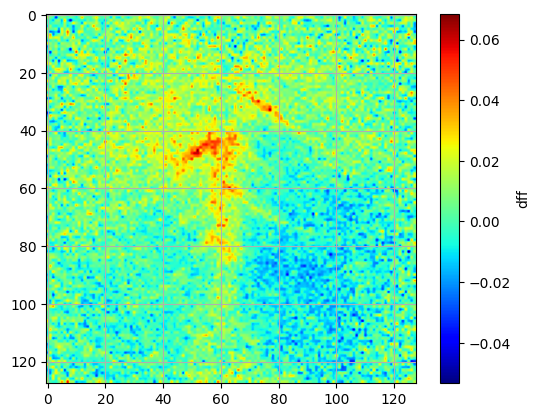

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:41,  3.05it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:36,  3.50it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:39,  3.15it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:37,  3.32it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:37,  3.25it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:37,  3.29it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:35,  3.41it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:40,  2.98it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:41,  2.85it/s]

  8%|██████▎                                                                          | 10/128 [00:03<00:41,  2.86it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:42,  2.75it/s]

  9%|███████▌                                                                         | 12/128 [00:04<00:43,  2.64it/s]

 10%|████████▏                                                                        | 13/128 [00:04<00:45,  2.54it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:45,  2.53it/s]

 12%|█████████▍                                                                       | 15/128 [00:05<00:44,  2.51it/s]

 12%|██████████▏                                                                      | 16/128 [00:05<00:45,  2.46it/s]

 13%|██████████▊                                                                      | 17/128 [00:06<00:41,  2.66it/s]

 14%|███████████▍                                                                     | 18/128 [00:06<00:39,  2.78it/s]

 15%|████████████                                                                     | 19/128 [00:06<00:39,  2.77it/s]

 16%|████████████▋                                                                    | 20/128 [00:07<00:38,  2.78it/s]

 16%|█████████████▎                                                                   | 21/128 [00:07<00:36,  2.90it/s]

 17%|█████████████▉                                                                   | 22/128 [00:07<00:34,  3.05it/s]

 18%|██████████████▌                                                                  | 23/128 [00:07<00:33,  3.13it/s]

 19%|███████████████▏                                                                 | 24/128 [00:08<00:33,  3.06it/s]

 20%|███████████████▊                                                                 | 25/128 [00:08<00:34,  3.02it/s]

 20%|████████████████▍                                                                | 26/128 [00:08<00:32,  3.12it/s]

 21%|█████████████████                                                                | 27/128 [00:09<00:30,  3.31it/s]

 22%|█████████████████▋                                                               | 28/128 [00:09<00:28,  3.46it/s]

 23%|██████████████████▎                                                              | 29/128 [00:09<00:28,  3.53it/s]

 23%|██████████████████▉                                                              | 30/128 [00:09<00:26,  3.67it/s]

 24%|███████████████████▌                                                             | 31/128 [00:10<00:25,  3.74it/s]

 25%|████████████████████▎                                                            | 32/128 [00:10<00:29,  3.27it/s]

 26%|████████████████████▉                                                            | 33/128 [00:10<00:27,  3.42it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:11<00:28,  3.28it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:11<00:28,  3.25it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:11<00:28,  3.23it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:12<00:27,  3.31it/s]

 30%|████████████████████████                                                         | 38/128 [00:12<00:27,  3.28it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:12<00:26,  3.40it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:13<00:27,  3.25it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:13<00:26,  3.26it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:13<00:27,  3.11it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:14<00:26,  3.25it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:14<00:25,  3.26it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:14<00:24,  3.37it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:14<00:25,  3.28it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:15<00:24,  3.28it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:15<00:25,  3.08it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:15<00:24,  3.16it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:16<00:23,  3.28it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:16<00:22,  3.38it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:16<00:21,  3.47it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:17<00:21,  3.44it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:17<00:21,  3.50it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:17<00:20,  3.53it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:17<00:22,  3.24it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:18<00:21,  3.27it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:18<00:22,  3.13it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:18<00:21,  3.23it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:19<00:21,  3.17it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:19<00:20,  3.22it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:19<00:20,  3.19it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:20<00:19,  3.32it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:20<00:20,  3.19it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:20<00:19,  3.31it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:21<00:19,  3.19it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:21<00:18,  3.22it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:21<00:18,  3.28it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:21<00:17,  3.44it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:22<00:17,  3.36it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:22<00:17,  3.30it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:22<00:18,  3.00it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:23<00:17,  3.09it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:23<00:17,  3.12it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:23<00:16,  3.22it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:24<00:15,  3.31it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:24<00:14,  3.42it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:24<00:14,  3.50it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:24<00:14,  3.41it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:25<00:15,  3.08it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:25<00:14,  3.15it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:25<00:14,  3.15it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:26<00:14,  3.15it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:26<00:13,  3.33it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:26<00:12,  3.34it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:27<00:12,  3.27it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:27<00:12,  3.22it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:27<00:12,  3.24it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:28<00:11,  3.26it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:28<00:11,  3.34it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:28<00:11,  3.35it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:28<00:10,  3.45it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:29<00:09,  3.52it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:29<00:09,  3.60it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:29<00:08,  3.72it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:30<00:08,  3.65it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:30<00:08,  3.51it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:30<00:08,  3.61it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:30<00:08,  3.51it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:31<00:07,  3.61it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:31<00:07,  3.40it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:31<00:07,  3.35it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:32<00:07,  3.43it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:32<00:07,  3.33it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:32<00:06,  3.35it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:32<00:06,  3.39it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:33<00:06,  3.28it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:33<00:06,  3.12it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:34<00:06,  3.01it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:34<00:05,  3.18it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:34<00:05,  3.21it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:34<00:05,  3.13it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:35<00:04,  3.24it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:35<00:04,  3.08it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:35<00:04,  3.05it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:36<00:03,  3.15it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:36<00:03,  3.31it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:36<00:02,  3.42it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:37<00:02,  3.47it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:37<00:02,  3.25it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:37<00:02,  3.09it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:38<00:01,  3.05it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:38<00:01,  3.14it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:38<00:01,  3.25it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:38<00:00,  3.24it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:39<00:00,  3.02it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:39<00:00,  2.94it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:40<00:00,  3.05it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:40<00:00,  3.20it/s]

frame number 200 plotted


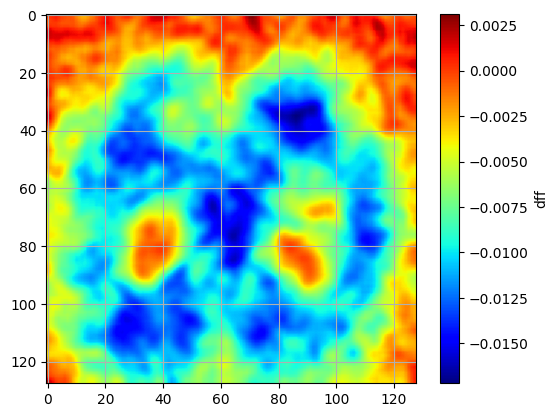

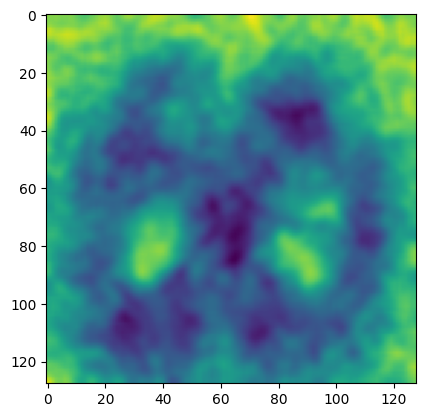

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 13


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 28
fail = 24
total trials = 52


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 7
fail = 28
total trials = 35


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 7
fail = 6
total trials = 13


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/34495 [00:00<?, ?it/s]

  5%|███▍                                                                      | 1591/34495 [00:00<00:02, 15758.64it/s]

 12%|████████▉                                                                 | 4168/34495 [00:00<00:01, 21503.22it/s]

 20%|██████████████▍                                                           | 6755/34495 [00:00<00:01, 23384.72it/s]

 28%|████████████████████▋                                                     | 9647/34495 [00:00<00:00, 25461.26it/s]

 35%|█████████████████████████▊                                               | 12224/34495 [00:00<00:00, 25484.14it/s]

 43%|███████████████████████████████▌                                         | 14887/34495 [00:00<00:00, 25787.49it/s]

 51%|█████████████████████████████████████▏                                   | 17543/34495 [00:00<00:00, 25957.33it/s]

 58%|██████████████████████████████████████████▌                              | 20139/34495 [00:00<00:00, 25557.33it/s]

 66%|████████████████████████████████████████████████                         | 22696/34495 [00:00<00:00, 23014.10it/s]

 73%|████████████████████████████████████████████████████▉                    | 25042/34495 [00:01<00:00, 22317.54it/s]

 80%|██████████████████████████████████████████████████████████▍              | 27621/34495 [00:01<00:00, 23233.38it/s]

 87%|███████████████████████████████████████████████████████████████▍         | 29974/34495 [00:01<00:00, 22459.77it/s]

 95%|█████████████████████████████████████████████████████████████████████    | 32622/34495 [00:01<00:00, 23530.92it/s]

100%|█████████████████████████████████████████████████████████████████████████| 34495/34495 [00:01<00:00, 23862.79it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 13338.12it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25012.25it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")